# FYP - Investigation of Visual Bias in Generative AI

## Introduction 

The outstanding results of Generative AI in creating new visual content, primarily images, have attracted the attention of various individuals.  Platforms such as Mid-Journey, DALL-E2 and Stable Diffusion have empowered many individuals to create custom content based on text prompts and use the output in various contexts. This ranges from entertainment and arts to the generation of images for articles. The output could be biased, depending on the data in the training set and/or in the latent space that the diffusion model uses in the generation phase.  

This project aims to investigate the bias of Generative AI by focusing on the open source and queryable dataset LAION-5B that is used to train the StableDiffusion model. Given a prompt and the stochastic nature of the model, different output results can be investigated for bias. The main elements of the prompt will also be used to investigate the images in the dataset. This will provide insight into whether there is any bias in the output and, if so, from where it originated.  

For example, the prompt “A doctor having a conversation with a nurse” can be used.  The project will use existing and evaluated computer vision techniques to classify the gender of the doctor and nurse at the output.  The same can be done on the images in the dataset for the key entities, in this case, “doctor” and “nurse”.  Since the prompt did not specify the gender of either entity, the output should be fairly balanced in the choice of gender.    

## Notebook outline

1. ### [Libraries Used](#Libraries-Used)
2. ### [Loading Dataset](#Loading-Dataset)
3. ### [Facial Detector Implementation](#Facial-Detector-Implementation)
    - ### [DeepFace](#DeepFace)
    - ### [Inferdo](#Inferdo)
    - ### [BetaFace](#BetaFace)
4. ### [Facial Detector Comparison](#Facial-Detector-Comparison)
5. ### [LAION-5B Image Retrieval](#LAION-5B-Image-Retrieval)
6. ### [Paramater Testing](#Paramater-Testing)

## Libraries Used

This section of the notebook lists the entire set of libraries used to facilitate the project. 

**Note:** The libraries specific to each individual cell will also be present in said cell as comments

In [1]:
import numpy as np
import cv2
import requests
import pandas as pd
import glob
import requests
import urllib.request

from io import BytesIO
from IPython.display import Image, display
from clip_retrieval.clip_client import ClipClient, Modality
from matplotlib import pyplot as plt
from deepface import DeepFace
from PIL import Image as PImg

## Loading Dataset
This section of the notebook involves loading the FairFace dataset. This is required to facilitate comparison between the three candidate API's, these being DeepFace, Inferdo & BetaFace.

The aformentioned dataset can either be loaded/stored locally utilising the code below however it was decided to load only the first 100 images via links so as to allow the notebook to be used without requiring the dataset. 


**Note:** The dataset can be found from the following [link](https://www.kaggle.com/datasets/lantian773030/fairface?resource=download)

In [2]:
# # Specifying the image folder path
# folder_path = 'FairFace/train/'  

# # Retrieving a list of all image file paths in the folder
# image_paths = glob.glob(folder_path)

# # Iterating over each image path and loading the images
# images = []

# no_of_images = 100

# for index in range(1, no_of_images):
#     image = cv2.imread(folder_path+str(index)+".jpg")
#     if image is not None:
#         images.append(image[:,:,::-1])
#     else:
#         print(f"Failed to load image: {image_paths[image_path]}")

In [3]:
# Required import
# import urllib.request

# Unorderd list of first 100 images in the dataset in url form, this was facilitated through the following link: 
# https://postimg.cc/gallery/nxY6KQ7/dda9d683

imgUrl = [
"https://i.postimg.cc/N0f1ZmZp/1.jpg",
"https://i.postimg.cc/KYzM0FgW/10.jpg",
"https://i.postimg.cc/dQTSWc2D/100.jpg",
"https://i.postimg.cc/bvB2MMxw/11.jpg",
"https://i.postimg.cc/Hx87C2z4/12.jpg",
"https://i.postimg.cc/nrvjXh6X/13.jpg",   
"https://i.postimg.cc/j2Vnq7kV/14.jpg",
"https://i.postimg.cc/2jvBc0VC/15.jpg",
"https://i.postimg.cc/ZKSv16dp/16.jpg",
"https://i.postimg.cc/WbwqjtGK/17.jpg",
"https://i.postimg.cc/tgYsh5KQ/18.jpg",
"https://i.postimg.cc/CKXzJ80Z/19.jpg",
"https://i.postimg.cc/2yvvnwB8/2.jpg",
"https://i.postimg.cc/63ZTPQ6M/20.jpg",
"https://i.postimg.cc/T1XhvXpf/21.jpg",
"https://i.postimg.cc/4ybyJF9t/22.jpg",
"https://i.postimg.cc/tRhYt7MT/23.jpg",
"https://i.postimg.cc/fTCyppZQ/24.jpg",
"https://i.postimg.cc/kg5GmsX6/25.jpg",
"https://i.postimg.cc/7ZQ6YzfB/26.jpg",
"https://i.postimg.cc/BvLv8vFJ/27.jpg",
"https://i.postimg.cc/GpWmv1PG/28.jpg",
"https://i.postimg.cc/0Q72fHZ3/29.jpg",
"https://i.postimg.cc/C19kZt5Q/3.jpg",
"https://i.postimg.cc/hvg43b5G/30.jpg",
"https://i.postimg.cc/zvjDmbsF/31.jpg",
"https://i.postimg.cc/J7czHvsH/32.jpg",
"https://i.postimg.cc/Dyvyr6Gj/33.jpg",
"https://i.postimg.cc/gkgcNhqY/34.jpg",
"https://i.postimg.cc/mghLqr87/35.jpg",
"https://i.postimg.cc/6Qv9Wms3/36.jpg",
"https://i.postimg.cc/Z5gbhhM2/37.jpg",
"https://i.postimg.cc/Qtgh5KdZ/38.jpg",
"https://i.postimg.cc/5yx1m9XY/39.jpg",
"https://i.postimg.cc/JnsjzmrX/4.jpg",
"https://i.postimg.cc/D0BhpVGC/40.jpg",
"https://i.postimg.cc/kMc7gSHx/41.jpg",
"https://i.postimg.cc/7YZwG6vj/42.jpg",
"https://i.postimg.cc/J4YmbLM0/43.jpg",
"https://i.postimg.cc/T3yx0439/44.jpg",
"https://i.postimg.cc/9QvhnY4j/45.jpg",
"https://i.postimg.cc/fbmNnSXS/46.jpg",
"https://i.postimg.cc/xCQS0jyx/47.jpg",
"https://i.postimg.cc/63hxTsM9/48.jpg",
"https://i.postimg.cc/Pf2kjjLy/49.jpg",
"https://i.postimg.cc/c18Qqs5y/5.jpg",
"https://i.postimg.cc/0jWgdYgF/50.jpg",
"https://i.postimg.cc/QML2bNP8/51.jpg",
"https://i.postimg.cc/FHJt3kTC/52.jpg",
"https://i.postimg.cc/jd10D44J/53.jpg",
"https://i.postimg.cc/m2kWZ5Cs/54.jpg",
"https://i.postimg.cc/q789ZVV8/55.jpg",
"https://i.postimg.cc/85Nx2KNx/56.jpg",
"https://i.postimg.cc/nz2Np4Lr/57.jpg",
"https://i.postimg.cc/qq7SRNtL/58.jpg",
"https://i.postimg.cc/hv3w7KTq/59.jpg",
"https://i.postimg.cc/MK21qhhc/6.jpg",
"https://i.postimg.cc/SNJHbzbQ/60.jpg",
"https://i.postimg.cc/jq8B149k/61.jpg",
"https://i.postimg.cc/RVyySVv7/62.jpg",
"https://i.postimg.cc/2SWJVR5P/63.jpg",
"https://i.postimg.cc/vmdKnqgD/64.jpg",
"https://i.postimg.cc/nLYPG4B2/65.jpg",
"https://i.postimg.cc/zBzPtykr/66.jpg",
"https://i.postimg.cc/TwtNZTkW/67.jpg",
"https://i.postimg.cc/x8qpQB7p/68.jpg",
"https://i.postimg.cc/KjVq8JhG/69.jpg",
"https://i.postimg.cc/RZGt1qqf/7.jpg",
"https://i.postimg.cc/v8SShHgJ/70.jpg",
"https://i.postimg.cc/yYgpb40k/71.jpg",
"https://i.postimg.cc/bN7VXCRL/72.jpg",
"https://i.postimg.cc/bw1CqxCP/73.jpg",
"https://i.postimg.cc/0NxtjzFw/74.jpg",
"https://i.postimg.cc/Tw3CjZR2/75.jpg",
"https://i.postimg.cc/q7L13kHZ/76.jpg",
"https://i.postimg.cc/j2WcmPwG/77.jpg",
"https://i.postimg.cc/mDpVm8DY/78.jpg",
"https://i.postimg.cc/kGksmGWD/79.jpg",
"https://i.postimg.cc/bwqb21Yp/8.jpg",
"https://i.postimg.cc/jq9ZNgBK/80.jpg",
"https://i.postimg.cc/XY6L1ZVz/81.jpg",
"https://i.postimg.cc/KvMQ57yT/82.jpg",
"https://i.postimg.cc/y8hPMVxY/83.jpg",
"https://i.postimg.cc/Dz2gFt4Q/84.jpg",
"https://i.postimg.cc/mr8Sr87v/85.jpg",
"https://i.postimg.cc/Y90zLY3h/86.jpg",
"https://i.postimg.cc/HxN4wnZ3/87.jpg",
"https://i.postimg.cc/XqyKQWtW/88.jpg",
"https://i.postimg.cc/MpYLy0yD/89.jpg",
"https://i.postimg.cc/RV7KFgBg/9.jpg",
"https://i.postimg.cc/nMb4W5tD/90.jpg",
"https://i.postimg.cc/MZcghQS6/91.jpg",
"https://i.postimg.cc/44rjZxfz/92.jpg",
"https://i.postimg.cc/52JGYKFy/93.jpg",
"https://i.postimg.cc/pdX6k9Ct/94.jpg",
"https://i.postimg.cc/fTmpbQy1/95.jpg",
"https://i.postimg.cc/XvHDPV1B/96.jpg",
"https://i.postimg.cc/W3dfLQxW/97.jpg",
"https://i.postimg.cc/XJt1VsbV/98.jpg",
"https://i.postimg.cc/fyX2kYzY/99.jpg"]

# Function used to extract the JPG names from the URLs
def extract_jpg_name(url):
    return int(url.split('/')[-1].split('.')[0])

# Sorting the images based on the name
imgUrl = sorted(imgUrl, key=extract_jpg_name)

## Facial Detector Implementation

This section of the notebook includes the implementation of the API's utilising their default paramaters. 

In [4]:
# Function used to display the images alongside their relevant data
def ImageInfoDisplay(imageDict):
    for itemIndex in range(len(imageDict.items())):
        plt.imshow(imageDict[itemIndex][0], interpolation='nearest', cmap="gray")
        plt.axis("Off")
        text = ""
        
        # Determining the data to display based on the API used
        if 'age' in imageDict[itemIndex][1]:
            text += "Age: " + str(imageDict[itemIndex][1]['age'])
        
        if 'gender' in imageDict[itemIndex][1]:
            text += "\nGender: " + str(imageDict[itemIndex][1]['gender'])
            
        if 'race' in imageDict[itemIndex][1]:
            text += "\nRace: " + str(imageDict[itemIndex][1]['race'])
            
        if 'emotion' in imageDict[itemIndex][1]:
            text += "\nEmotion:" + str(imageDict[itemIndex][1]['emotion'])
        
        plt.text(0, imageDict[itemIndex][0].shape[0]-10, text, color='red')
        plt.show()

### DeepFace

The DeepFace API can be found from the following [link](https://github.com/serengil/deepface). 

The implementation itself follows the guide present on the APIs github page found through the same link.

In [5]:
# Required libraries

# from deepface import DeepFace

In [6]:
# Function which carries out the DeepFace API on the provided list of images
def DeepFaceProcess(listOfImages):
    # Dict used to store the images alongside their data
    DeepFaceDict = {}
    # Counter used to keep track of the dictionary position 
    counter = 0
    
    # Looping through the list of images
    for imgIndex in range(len(listOfImages)):
        try:
            # Retrieving the age/gender/race/emotion of the image
            # Note: enforce_detection=False used so that images where the face isn't fully visible are still considered
            objs = DeepFace.analyze(listOfImages[imgIndex], actions = ['age', 'gender', 'race', 'emotion'], enforce_detection=False)

            if objs[0]['dominant_gender'] == "Man":
                ImageInfo = {'age':objs[0]['age'], 'gender':"Male", 'race':objs[0]['dominant_race'], 'emotion':objs[0]['dominant_emotion']}
            elif objs[0]['dominant_gender'] == "Woman":
                ImageInfo = {'age':objs[0]['age'], 'gender':"Female", 'race':objs[0]['dominant_race'], 'emotion':objs[0]['dominant_emotion']}

            # Send a GET request to the URL and retrieving the image data
            response = requests.get(listOfImages[imgIndex])
            image_data = response.content

            # Converting the image to matrix form
            img = np.array(PImg.open(BytesIO(image_data)))

            # Storing the images in a dictionary 
            DeepFaceDict[counter] = [img,ImageInfo]
            counter+=1
        except:
            counter-=1
            print("Error: Image failed to be processed")
        
    return DeepFaceDict

Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.13it/s]


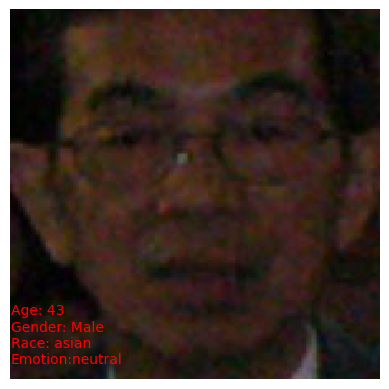

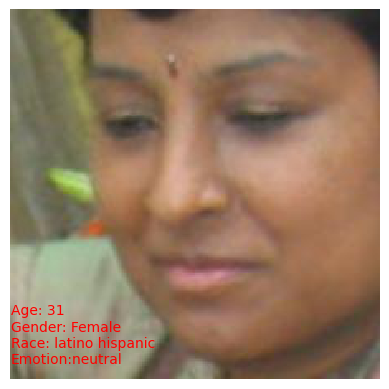

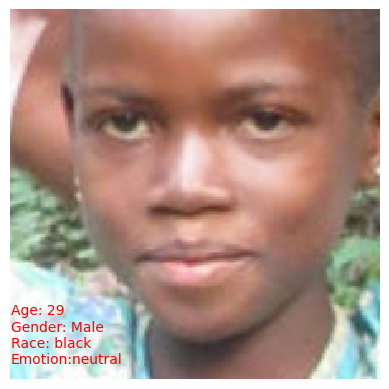

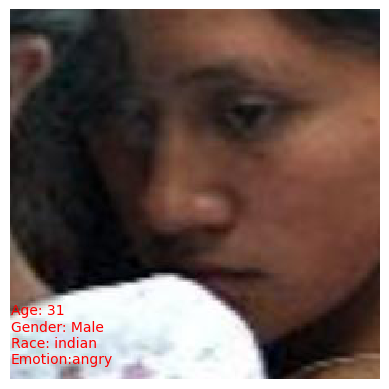

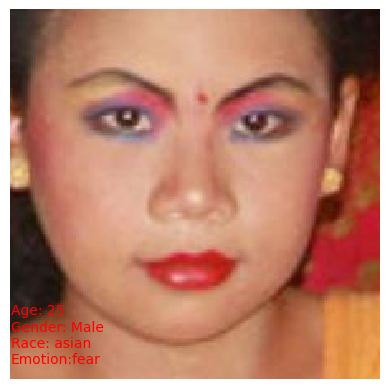

...

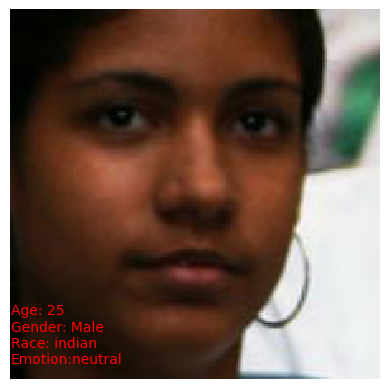

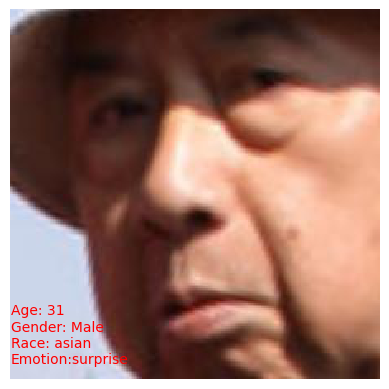

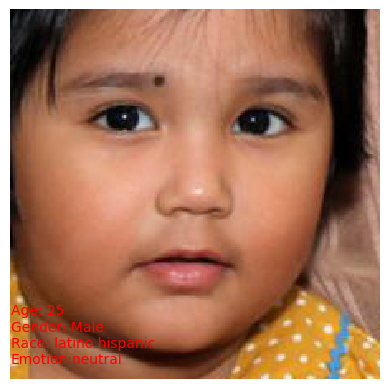

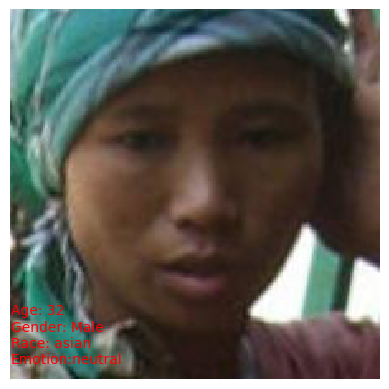

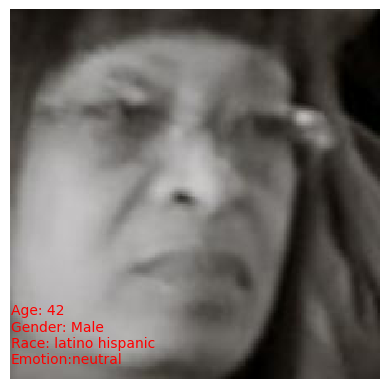

In [7]:
DeepFaceDict = DeepFaceProcess(imgUrl[0:50])

# Displaying the DeepFace processed images
ImageInfoDisplay(DeepFaceDict)

### Inferdo

The DeepFace API can be found from the following [link](https://inferdo.com/).

The implementation itself follows the guide present in the following [link](https://rapidapi.com/inferdo/api/face-detection6).

In [8]:
# Required libraries

# import requests
# from PIL import Image
# from io import BytesIO

In [9]:
# Function which carries out the Inferdo API on the provided list of images
def InferdoAPIProcess(imgUrls, accuracyLvl):
    # Dict used to store the images alongside their data
    InferdoAPIDict = {}
    
    # Specifying the required input data for the API
    url = "https://face-detection6.p.rapidapi.com/img/face-age-gender"
    
    headers = {
        "content-type": "application/json",
        "X-RapidAPI-Key": "2e915f0481msh738a16bbbadc6a5p1e4925jsn86a91ba9e1fd",
        "X-RapidAPI-Host": "face-detection6.p.rapidapi.com"
    }
    
    # Looping through all the image urls
    for imgIndex in range(len(imgUrls)):
        
        # Url denotes the image url to be processed & accuracy_boost denotes the accuracy that the API will utilise varies from 1 to 4
        payload = {
            "url": imgUrls[imgIndex],
            "accuracy_boost": accuracyLvl
        }

        # Sending a request to the API
        response = requests.post(url, json=payload, headers=headers)
        
        ImageInfo = ""
        
        # Retrieving the resultant data, 0 is used in case multiple faces are deteceted in a single image only the first one is considered
        if response.json()['detected_faces'] != []:
            gender = response.json()['detected_faces'][0]['Gender']['Gender']
            ageLow = response.json()['detected_faces'][0]['Age']['Age-Range']['Low']
            ageHigh = response.json()['detected_faces'][0]['Age']['Age-Range']['High']
            ImageInfo = {'age':str(ageLow)+" - "+str(ageHigh), 'gender':gender}
        
        # Send a GET request to the URL and retrieving the image data
        response = requests.get(imgUrls[imgIndex])
        image_data = response.content
        # Converting the image to matrix form
        img = np.array(PImg.open(BytesIO(image_data)))
      
        # Storing the images in a dictionary 
        InferdoAPIDict[imgIndex] = [img, ImageInfo]
        
    return InferdoAPIDict  

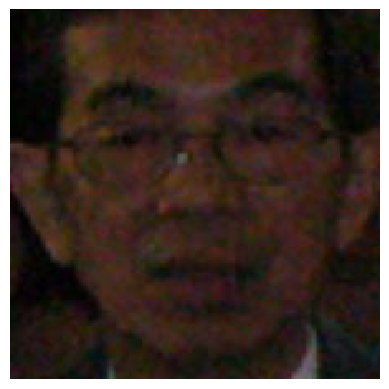

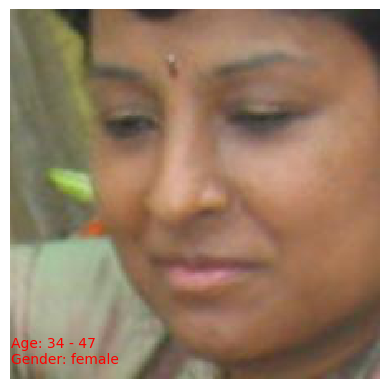

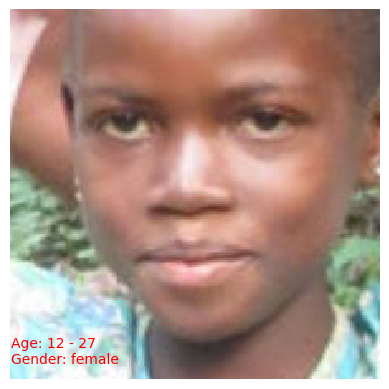

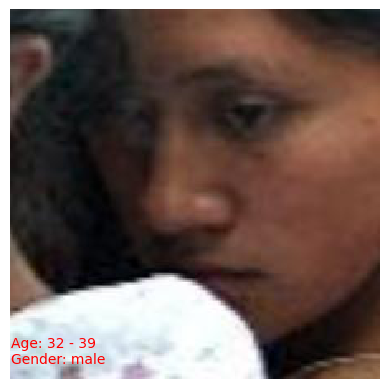

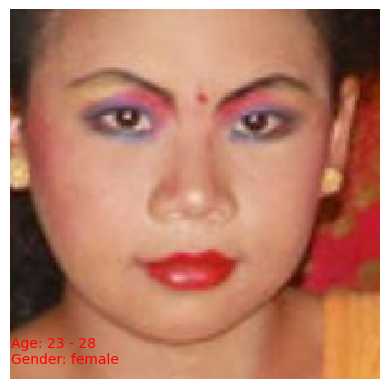

...

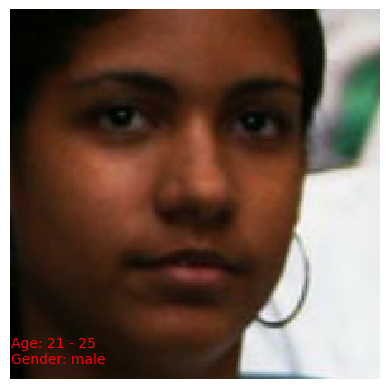

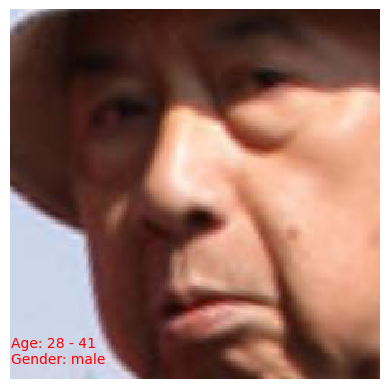

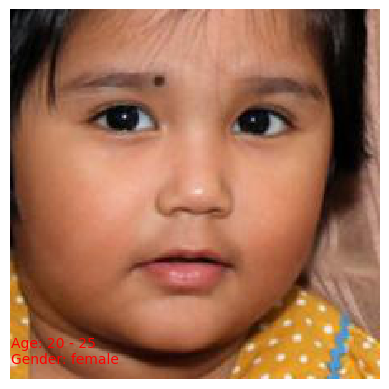

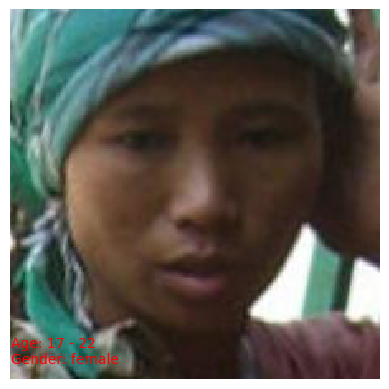

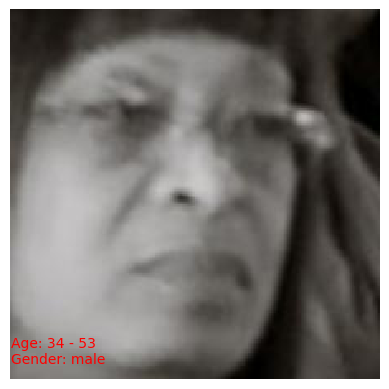

In [10]:
accuracyLvl = 3
InferdoAPIDict = InferdoAPIProcess(imgUrl[0:50], accuracyLvl)

# Displaying the Inferdo processed images
ImageInfoDisplay(InferdoAPIDict)

### BetaFace

The BetaFace API can be found from the following [link](https://www.betafaceapi.com/wpa/). 

The implementation itself follows the guide present in the following [video](https://www.youtube.com/watch?v=TIGV4sozmd0).

**Note:** In light of the fact that the BetaFace API had no clear way to acquire the non-free version in their website the free version is being utilised, which comes with a **50 image daily limit**.

In [11]:
# Required libraries

# import requests
# from PIL import Image
# from io import BytesIO

In [12]:
def BetaFaceAPIProcess(imgUrls):
    BetaFaceAPIDict = {}
    
    url = 'https://www.betafaceapi.com/api/v2/media'
    
    headers = {
        'accept': 'application/json',
        'Content-Type': 'application/json',
    }
    
    # Arbitrary name required by the API (can be cahnged to anything)
    filename = "tmp.jpg"
    
    # Looping through all the image urls
    for imgIndex in range(len(imgUrls)):
        
        # Url denotes the image url to be processed & accuracy_boost denotes the accuracy that the API will utilise varies from 1 to 4
        data = '{"api_key": "d45fd466-51e2-4701-8da8-04351c872236", "file_uri": "' + imgUrls[imgIndex] + '", "detection_flags": "basicpoints,propoints,classifiers,content", "recognize_targets": [ "all@mynamespace" ], "original_filename": "' + filename + '"}'
        
        # Sending a request to the API
        response = requests.post(url, headers=headers, data=data).json()
        
        ImageInfo = ""
        
        # Retrieving the resultant data, 0 is used in case multiple faces are deteceted in a sinhle image only the first one is considered
        if 'error_code' not in response and 'media' in response:
            if response['media']['faces'] != None:
                gender = response['media']['faces'][0]['tags'][18]['value']
                age = response['media']['faces'][0]['tags'][1]['value']
                emotion = response['media']['faces'][0]['tags'][17]['value']
                race = response['media']['faces'][0]['tags'][31]['value']

                ImageInfo = {'age':age, 'gender':gender, 'race':race, 'emotion':emotion}
            else:
                ImageInfo = {'age':0, 'gender':"n/a", 'race':"n/a", 'emotion':"n/a"}
        else:
            if response['error_code'] == -57:
                print("Maximum Daily Image Reached")
                break
                
        # Send a GET request to the URL and retrieving the image data
        response = requests.get(imgUrls[imgIndex])
        image_data = response.content
        # Converting the image to matrix form
        img = np.array(PImg.open(BytesIO(image_data)))
      
        BetaFaceAPIDict[imgIndex] = [img, ImageInfo]
        
    return BetaFaceAPIDict

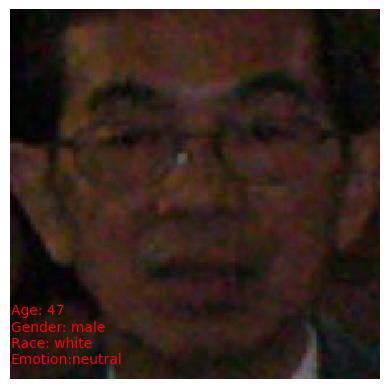

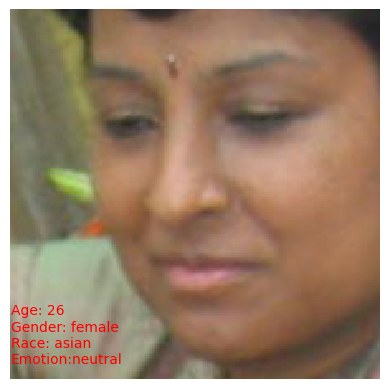

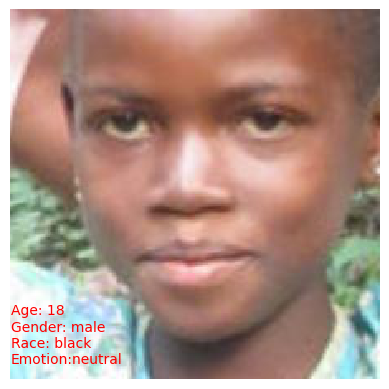

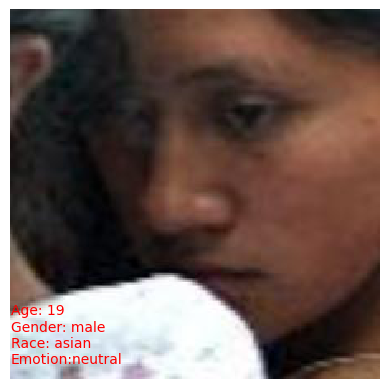

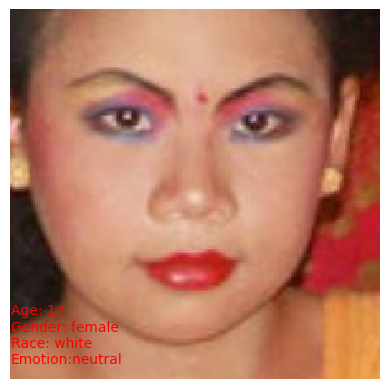

...

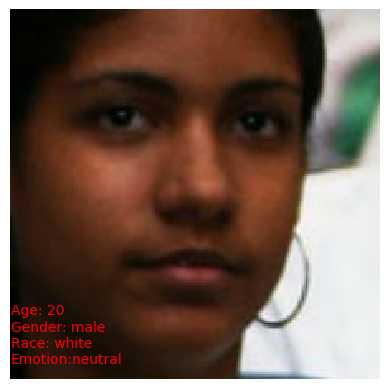

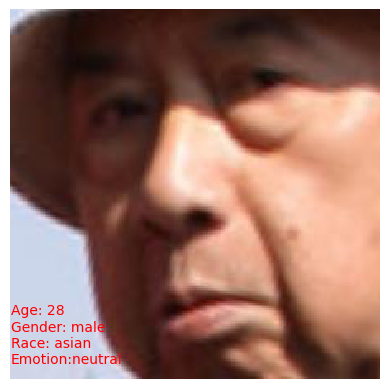

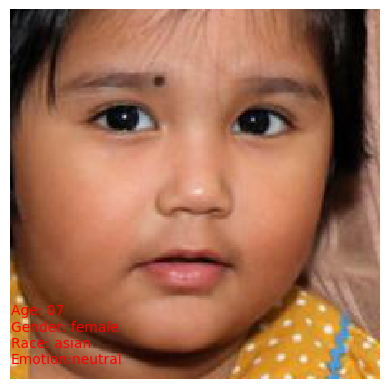

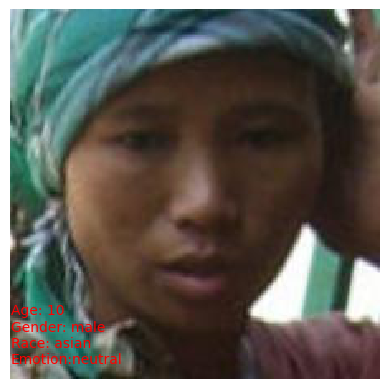

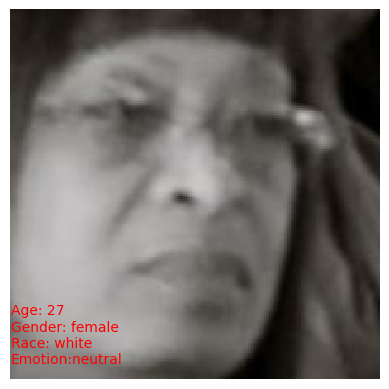

In [13]:
BetaFaceAPIDict = BetaFaceAPIProcess(imgUrl[0:50])
# Displaying the Inferdo processed images
ImageInfoDisplay(BetaFaceAPIDict)

## Facial Detector Comparison

This section of the notebook compares the outputs produced in the previous section with the ground truth of the FairFace dataset. This then leads to a conclusion as to which API is best out of the three.

In [14]:
# Retrieving the ground truth data link:https://github.com/dchen236/FairFace

# Specify the ground truth file path
csv_file = 'FairFace/groundTruth/fairface_label_train.csv'

df = pd.read_csv(csv_file)

In [15]:
# Retrivieng all unique races in the dataset, this is done to replace them with a label common to all three API's
uniqueRaces = df['race'].unique()
print(uniqueRaces)

['East Asian' 'Indian' 'Black' 'White' 'Middle Eastern' 'Latino_Hispanic'
 'Southeast Asian']


In [16]:
# Function used to replace data with its equivalent thus facilitating easier processing
def CleanFairFaceGroundTruth(df):
    df['race'].replace('East Asian', 'Asian', inplace=True)
    df['race'].replace('Latino_Hispanic', 'Latino', inplace=True)
    df['race'].replace('Southeast Asian', 'Asian', inplace=True)
    
CleanFairFaceGroundTruth(df)

In [17]:
# Function used to keep track of which results match with the groundturth 
def CompareResultsToGroundTruth(imageDict, groundTruth):
    #Counters used keep track of mis/matches
    ageMatchCounter = 0
    genderMatchCounter = 0
    raceMatchCounter = 0
    emotionMatchCounter = 0
    detection = 0
    
    ageMisMatchCounter = 0
    genderMisMatchCounter = 0
    raceMisMatchCounter = 0
    emotionMisMatchCounter = 0
    noDetection = 0
    
    for itemIndex in range(len(imageDict.items())):
        
        if imageDict[itemIndex][1] != '':
            detection +=1 
            
            # Checking for correct age assignment 
            if 'age' in imageDict[itemIndex][1] and 'age' in groundTruth:
                # Extract the lower and upper limits
                lower_limit, upper_limit = map(int, groundTruth['age'][itemIndex].split("-"))
                age = imageDict[itemIndex][1]['age']
                if lower_limit <= int(age) <= upper_limit:
                    ageMatchCounter+=1
                else:
                    ageMisMatchCounter+=1

            # Checking for correct gender assignment 
            if 'gender' in imageDict[itemIndex][1] and 'gender' in groundTruth:
                if imageDict[itemIndex][1]['gender'].lower() == groundTruth['gender'][itemIndex].lower():
                    genderMatchCounter+=1
                else:
                    genderMisMatchCounter+=1

            # Checking for correct race assignment 
            if 'race' in imageDict[itemIndex][1] and 'race' in groundTruth:
                if imageDict[itemIndex][1]['race'].lower() == groundTruth['race'][itemIndex].lower():
                    raceMatchCounter+=1
                else:
                    raceMisMatchCounter+=1

            # Checking for correct emotion assignment 
            if 'emotion' in imageDict[itemIndex][1] and 'emotion' in groundTruth:
                if imageDict[itemIndex][1]['emotion'].lower() == groundTruth['emotion'][itemIndex].lower():
                    emotionMatchCounter+=1
                else:
                    emotionMisMatchCounter+=1
        else:
            noDetection+=1
    
    return {'age':ageMatchCounter,
    'gender':genderMatchCounter,
    'race':raceMatchCounter,
    'emotion':emotionMatchCounter,
    'ageNot':ageMisMatchCounter,
    'genderNot':genderMisMatchCounter,
    'raceNot':raceMisMatchCounter,
    'emotionNot':emotionMisMatchCounter,
    'detection': detection,
    'detectionNot':noDetection}

In [72]:
# Function which draws a bar chart of the passed data
def DrawBarChart(category, listOfDicts):
    barWidth = 0.25
    fig = plt.subplots(figsize =(12, 8))

    # set height of bar
    Correct = []
    Incorrect = []
    
    for key in listOfDicts.keys():
        Correct.append(listOfDicts[key][category])
        Incorrect.append(listOfDicts[key][category+'Not'])

    # Set position of bar on X axis
    br1 = np.arange(len(Correct))
    br2 = [x + barWidth for x in br1]

    # Make the plot
    plt.bar(br1, Correct, color ='g', width = barWidth,
            edgecolor ='grey', label ='Correct')
    plt.bar(br2, Incorrect, color ='r', width = barWidth,
            edgecolor ='grey', label ='Incorrect')

    # Adding Xticks
    plt.xlabel('API', fontweight ='bold', fontsize = 15)
    plt.ylabel('No. of Images', fontweight ='bold', fontsize = 15)
    plt.xticks([r + barWidth for r in range(len(Correct))],listOfDicts.keys())
    plt.title(category)
    
    # Adding value labels above each bar
    for i, val in enumerate(Correct):
        plt.text(br1[i], val, str(val), ha='center', va='bottom', fontsize=12)
        
    for i, val in enumerate(Incorrect):
        plt.text(br2[i], val, str(val), ha='center', va='bottom', fontsize=12)
    
    plt.legend()
    plt.show()

In [19]:
DeepFaceComparisonResults = CompareResultsToGroundTruth(DeepFaceDict,df)

In [20]:
# Inferdo API data cleanup - since the api returns a range for the age of the detected face the average value of the lower 
# and upper range limit is calculted and used. This is done to simplify processing
for itemIndex in range(len(InferdoAPIDict)):
    if InferdoAPIDict[itemIndex][1]:
        if InferdoAPIDict[itemIndex][1]['age']:
            
            lower_limit, upper_limit = map(int, InferdoAPIDict[itemIndex][1]['age'].split("-"))
            
            # Converting the age range into an average of the lower/upper limits
            InferdoAPIDict[itemIndex][1]['age'] = round((lower_limit + upper_limit)/2)

In [21]:
InferdoAPICompareResults = CompareResultsToGroundTruth(InferdoAPIDict, df)

In [22]:
BetaFaceCompareResults = CompareResultsToGroundTruth(BetaFaceAPIDict, df)

### Output Visualisation

In [78]:
listOfDicts = {'Deepface':DeepFaceComparisonResults, 'Inferdo':InferdoAPICompareResults, 'BetaFace':BetaFaceCompareResults}

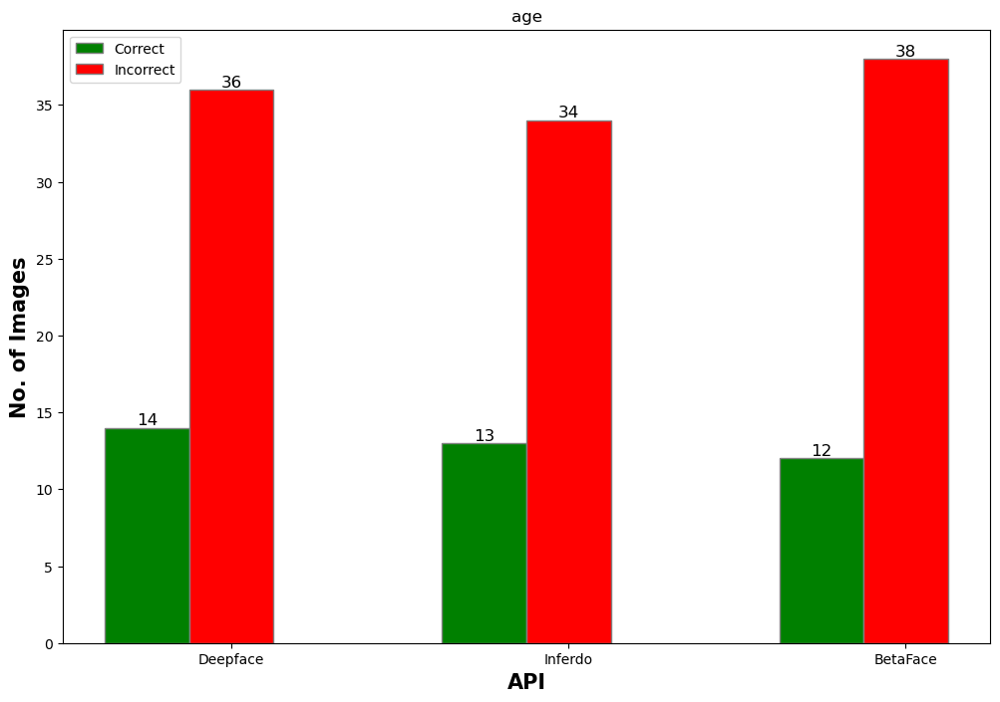

In [79]:
category = 'age'
DrawBarChart(category, listOfDicts)

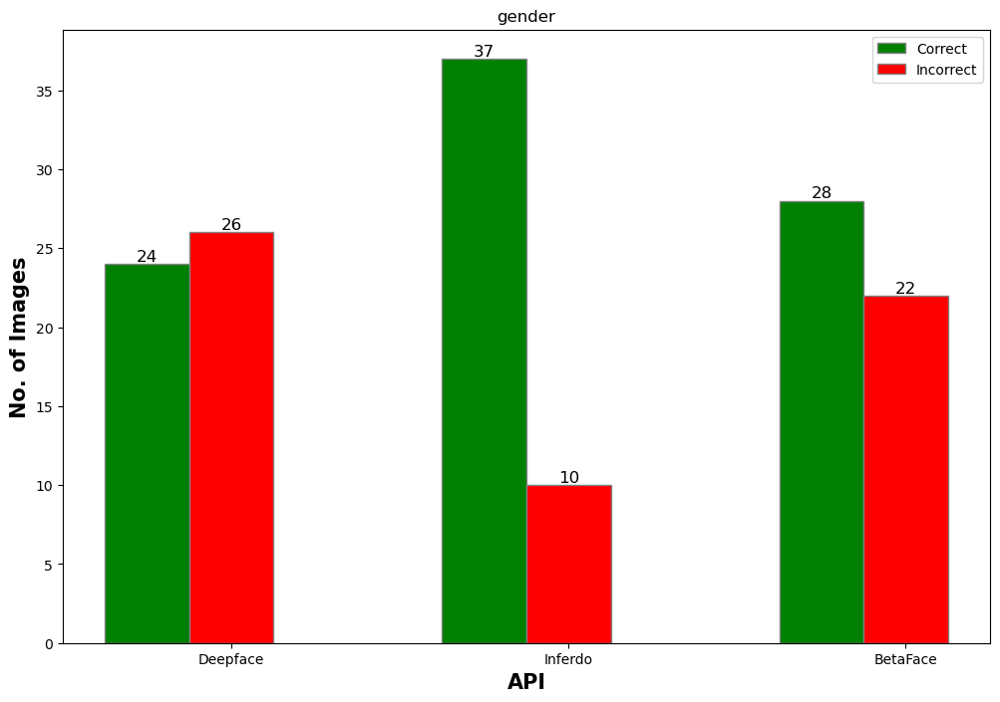

In [80]:
category = 'gender'
DrawBarChart(category, listOfDicts)

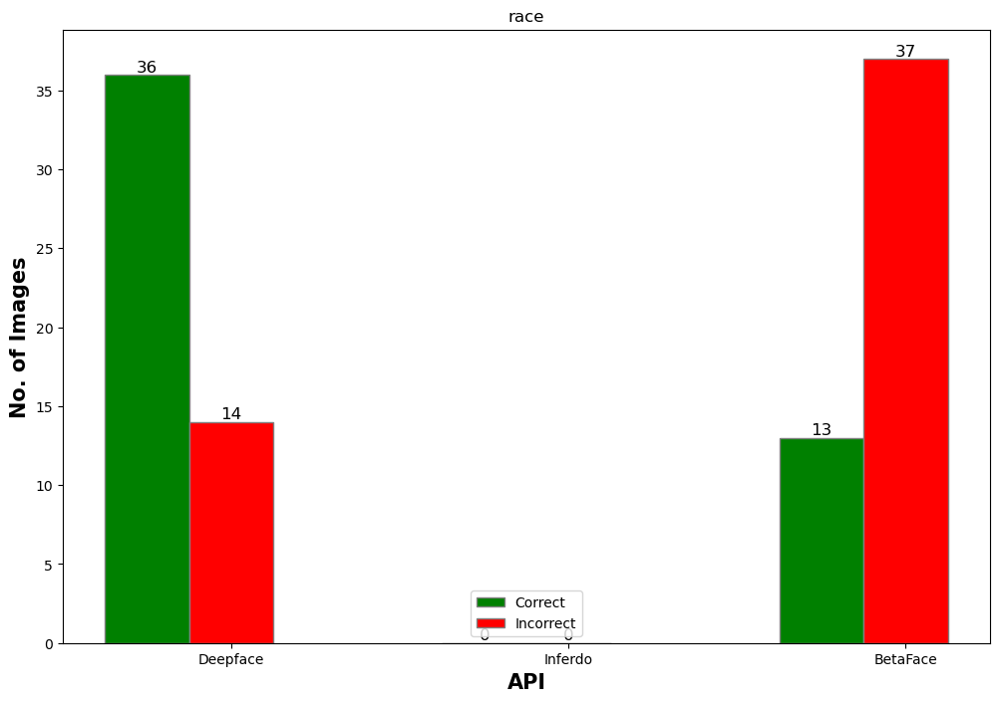

In [81]:
category = 'race'
DrawBarChart(category, listOfDicts)

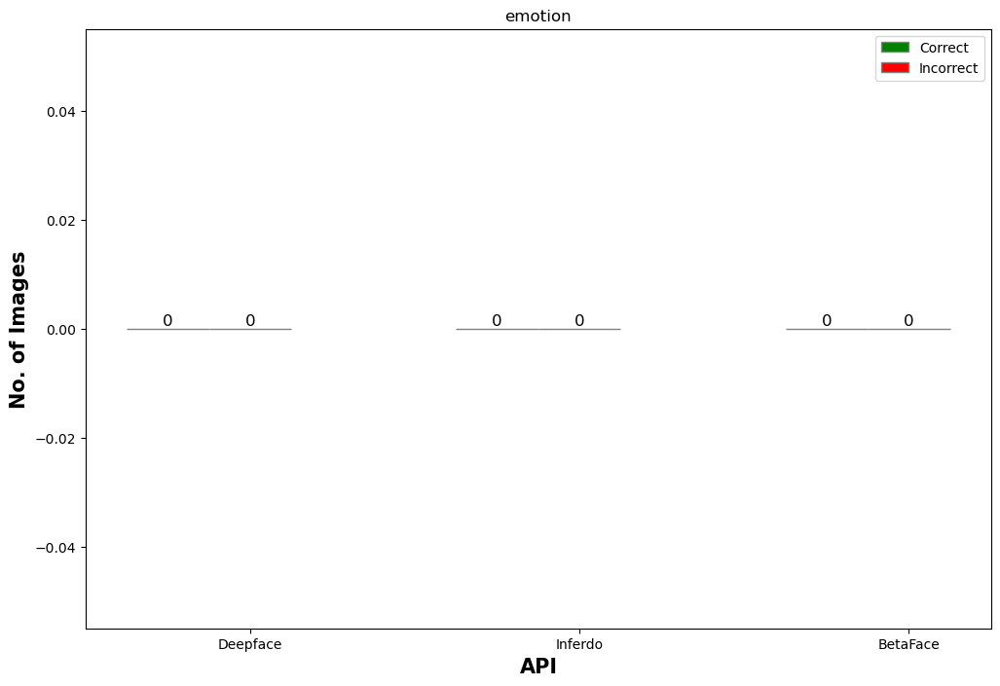

In [82]:
category = 'emotion'
DrawBarChart(category, listOfDicts)

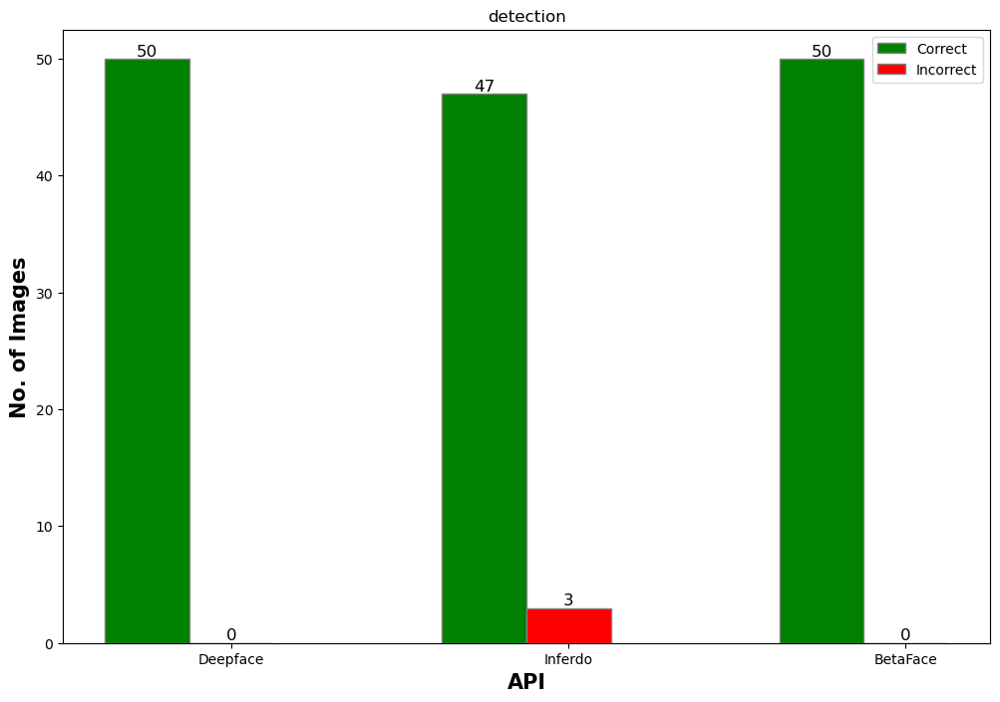

In [83]:
category = 'detection'
DrawBarChart(category, listOfDicts)

### Conclusion

In light of the fact that the Inferdo API does not possess race & emotion detection along with the fact that certain images couldnt be processed it was choosen to foroe using it. Similiary the BetaFace API was also not utilised as alhough it has the same capabilites as the DeepFace API it produce significantly worse in relation to race detection whilst only being margianlly better at gender detection. Thus, it was determiend appropriate that the DeepFace API would be utilised going forward.

## LAION-5B Image Retrieval

This section of the notebook focuses on querying the LAION-5B dataset via CLIP to retrieve images relevant to the prompt. These are later used in conjuction with DeepFace to facilitate bias detection in the LAION-5B dataset. 

In [37]:
# %pip install clip-retrieval img2dataset

In [38]:
#Code-Link: https://colab.research.google.com/github/rom1504/clip-retrieval/blob/master/notebook/clip-client-query-api.ipynb#scrollTo=LtInBZF-vTuE

from IPython.display import Image, display
from clip_retrieval.clip_client import ClipClient, Modality

In [39]:
# Function used to retrive images from the LAION-5B dataset 
def retrieveImages(text, aes_score, aes_weight, num_of_images):
    client = ClipClient(
        url="https://knn.laion.ai/knn-service",
        indice_name="laion5B-H-14",
        aesthetic_score=aes_score,
        aesthetic_weight=aes_weight,
        modality=Modality.IMAGE,
        num_images=num_of_images,
    )
    
    img_result = client.query(text)
        
    return img_result

In [54]:
# from deepface import DeepFace

# This function is an improved implementation of the previous DeepFaceProcess function, 
# having multi face detection capabilites whilst using the mtcnn detector backend  
def DeepFaceProcess(listOfImages):
    DeepFaceDict = {}
    counter = 0
    
    for imgIndex in range(len(listOfImages)):
        try:
            # Retrieving the age/gender/race/emotion of the image
            # Note: enforce_detection=False used so that images where the face isn't fully visible are still considered
            objs = DeepFace.analyze(listOfImages[imgIndex], actions = ['age', 'gender', 'race', 'emotion'], enforce_detection=False,  detector_backend = "mtcnn")
            
            for index in range(len(objs)):
                if objs[index]['dominant_gender'] == "Man":
                    ImageInfo = {'age':objs[index]['age'], 'gender':"Male", 'race':objs[index]['dominant_race'], 'emotion':objs[index]['dominant_emotion']}
                elif objs[index]['dominant_gender'] == "Woman":
                    ImageInfo = {'age':objs[index]['age'], 'gender':"Female", 'race':objs[index]['dominant_race'], 'emotion':objs[index]['dominant_emotion']}
                
                # Cropping the image to only include the face
                objs[index]['region']
                x = objs[index]['region']['x']
                y = objs[index]['region']['y']
                width = objs[index]['region']['x'] + objs[index]['region']['w']
                height = objs[index]['region']['y'] + objs[index]['region']['h']
                croppedImg = listOfImages[imgIndex][y:height, x:width]
                
                # Storing the images in a dictionary 
                DeepFaceDict[counter] = [croppedImg,ImageInfo]
                counter+=1
        except Exception as error:
            counter-=1
            print(error)
        
    return DeepFaceDict

In [55]:
import urllib.request

# Function which utilising the passed paramaters queries the LAION-5B dataset and passes the retrieved images through
# the DeepFace API, finally displaying the detected faces along with the processed data
def SearchQueryFunc(text, aes_score,aes_weight, num_of_images):

    img_results = retrieveImages(text, aes_score, aes_weight, num_of_images+1)
    
    # Storing the images in a list
    list_of_images = []

    # Retrieving the images from their respective url
    for x in range(len(img_results)):
        image_url = img_results[x]['url']

        try:
            image_data = urllib.request.urlopen(image_url)

            # Read the downloaded image data
            image = plt.imread(image_data, format='jpg')

            list_of_images.append(image)

        except Exception as error:
            print(error)
            
    DeepFaceDict = DeepFaceProcess(list_of_images)
    
    ImageInfoDisplay(DeepFaceDict)

HTTP Error 403: Forbidden
1/1 [==============================] - 0s 32ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.27it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.30it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 38ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.75it/s]


1/1 [==============================] - 0s 17ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.75it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.70it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


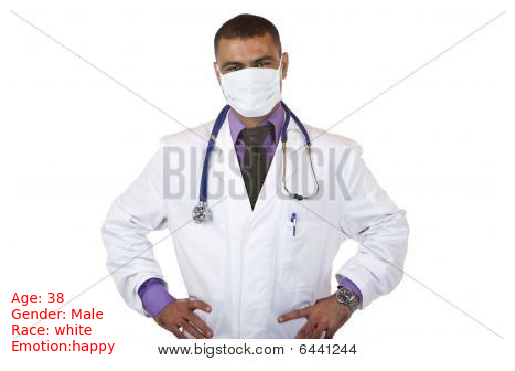

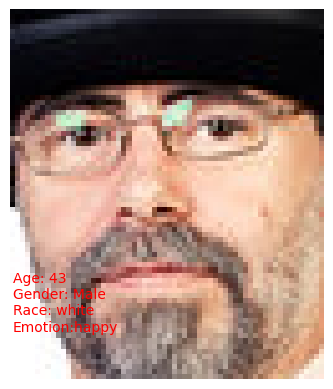

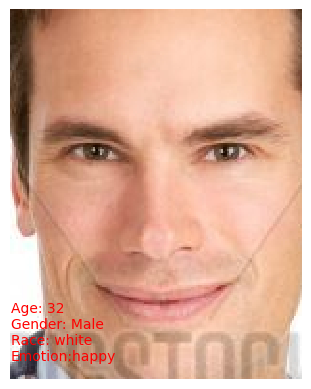

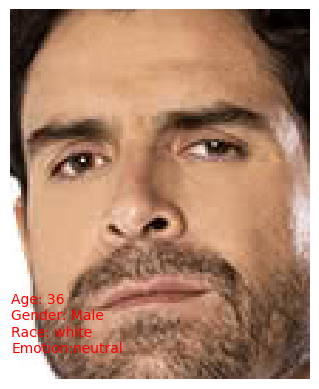

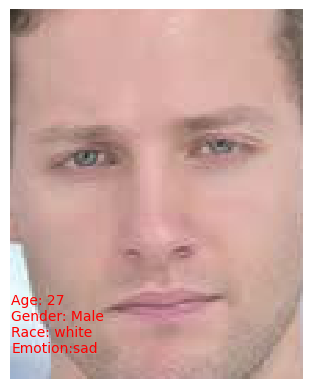

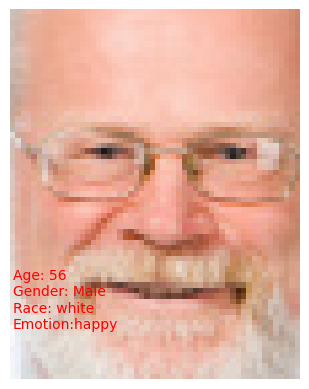

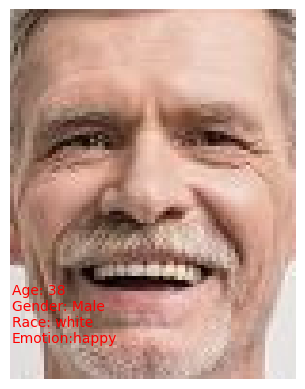

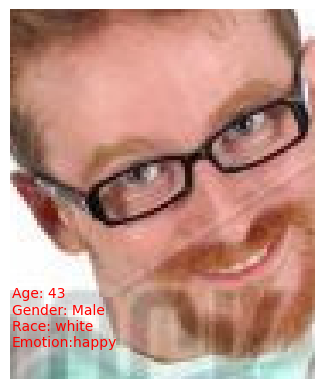

In [57]:
# Retrieving the indicated images 
text = "Real Human Doctor"
aes_score = 9
aes_weight = 0.5
num_of_images = 10

SearchQueryFunc(text, aes_score, aes_weight, num_of_images)

## Paramater Testing

This section of the notebook focuses on determining the best set of paramaters to utilise for the LAION-5B Clip retrieval & the best backend for the DeepFace implementation.

### DeepFace Face Alignment Backend

Throughout this section the FairFace dataset images previously utilised were reused. This was done as said images are ccompanied with a ground truth which simplifies testing. 

The available DeepFace face alignment backends are as follows:
- opencv 
- ssd 
- dlib 
- mtcnn 
- retinaface 
- mediapipe
- yolov8
- yunet

However excluding **opencv**, **mtcnn** & **retinaface** the remaining backends all proved problematic due, to raising errors throughout the implementation process. Thus, the testing carried out considers only the former three backends. 

In [58]:
images = []

for img_url in imgUrl:
    image_data = urllib.request.urlopen(img_url)
    
    img = plt.imread(image_data, format='jpg')
    
    images.append(img)

In [61]:
# Using working backends only
# Commented backends produced errors when attempting to utilise them 
backends = [
  'opencv', 
  #'ssd', 
  #'dlib', 
  'mtcnn', 
  'retinaface', 
  #'mediapipe',
  #'yolov8',
  #'yunet',
]

BackendDict = {}


# Change this to use the first implementation of the DeepFace function
for bk in backends: 
    counter = 0
    tmpDict = {}
    for img in images:
        try:
            # Retrieving the age/gender/race/emotion of the image
            # Note: enforce_detection=False used so that images where the face isn't fully visible are still considered
            objs = DeepFace.analyze(img, actions = ['age', 'gender', 'race', 'emotion'], enforce_detection=False, detector_backend = bk)

            if objs[0]['dominant_gender'] == "Man":
                ImageInfo = {'age':objs[0]['age'], 'gender':"Male", 'race':objs[0]['dominant_race'], 'emotion':objs[0]['dominant_emotion']}
            elif objs[0]['dominant_gender'] == "Woman":
                ImageInfo = {'age':objs[0]['age'], 'gender':"Female", 'race':objs[0]['dominant_race'], 'emotion':objs[0]['dominant_emotion']}

            # Storing the images in a dictionary 
            tmpDict[counter] = [img,ImageInfo]
            counter+=1
        except Exception as error:
            counter-=1
            print(error)
            
    BackendDict[bk] = tmpDict

Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.59it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.32it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.49it/s]


1/1 [==============================] - 0s 34ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.68it/s]


1/1 [==============================] - 0s 24ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.70it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.73it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.39it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.09it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.59it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.59it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.52it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.20it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.63it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.62it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.52it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.50it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.12it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.60it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.45it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.21it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.62it/s]


1/1 [==============================] - 0s 34ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.65it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.59it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.25it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.38it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.53it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.33it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.38it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.56it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.16it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.46it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.44it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.15it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.51it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.49it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.44it/s]


1/1 [==============================] - 0s 34ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.46it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.46it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.33it/s]


1/1 [==============================] - 0s 28ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.20it/s]


1/1 [==============================] - 0s 31ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.94it/s]


1/1 [==============================] - 0s 32ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.41it/s]


1/1 [==============================] - 0s 19ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.46it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


1/1 [==============================] - 0s 27ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.39it/s]


1/1 [==============================] - 0s 42ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.34it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]


1/1 [==============================] - 0s 28ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.33it/s]


1/1 [==============================] - 0s 29ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.45it/s]


1/1 [==============================] - 0s 30ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.39it/s]


1/1 [==============================] - 0s 34ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.20it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.69it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.19it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.71it/s]


1/1 [==============================] - 0s 25ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.94it/s]


1/1 [==============================] - 0s 33ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.79it/s]


1/1 [==============================] - 0s 40ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.97it/s]


1/1 [==============================] - 0s 29ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.26it/s]


1/1 [==============================] - 0s 60ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.99it/s]


1/1 [==============================] - 0s 31ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.72it/s]


1/1 [==============================] - 0s 40ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.03it/s]


1/1 [==============================] - 0s 31ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.08it/s]


1/1 [==============================] - 0s 27ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.40it/s]


1/1 [==============================] - 0s 27ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  3.02it/s]


1/1 [==============================] - 0s 41ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]


1/1 [==============================] - 0s 35ms/step


Action: emotion: 100%|██████████| 4/4 [00:01<00:00,  2.74it/s]


In [62]:
BECompResOpenCV = CompareResultsToGroundTruth(BackendDict['opencv'],df)

In [63]:
BECompResMtcnn = CompareResultsToGroundTruth(BackendDict['mtcnn'],df)

In [64]:
BECompResRetFace = CompareResultsToGroundTruth(BackendDict['retinaface'],df)

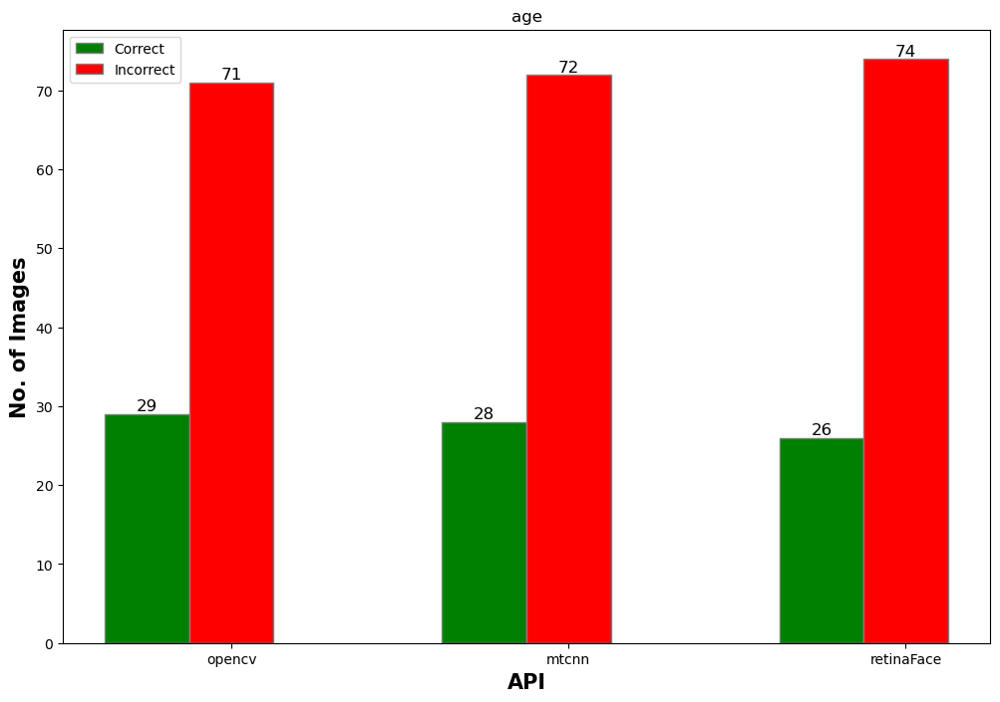

In [84]:
listOfDicts = {'opencv':BECompResOpenCV, 'mtcnn':BECompResMtcnn, 'retinaFace':BECompResRetFace}
category = 'age'
DrawBarChart(category, listOfDicts)

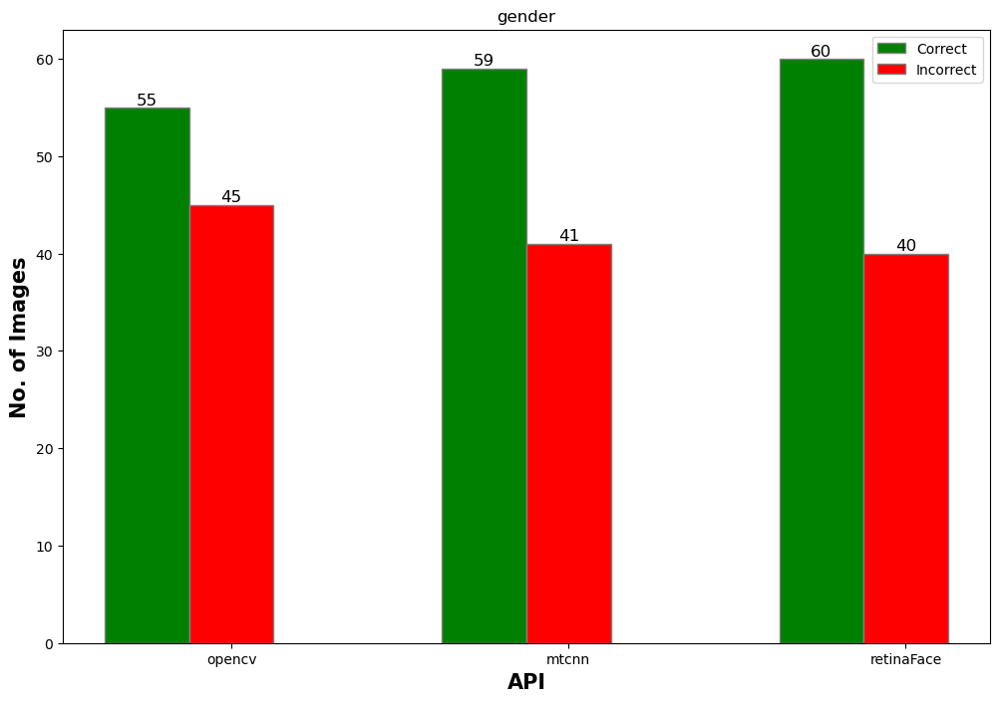

In [85]:
listOfDicts = {'opencv':BECompResOpenCV, 'mtcnn':BECompResMtcnn, 'retinaFace':BECompResRetFace}
category = 'gender'
DrawBarChart(category, listOfDicts)

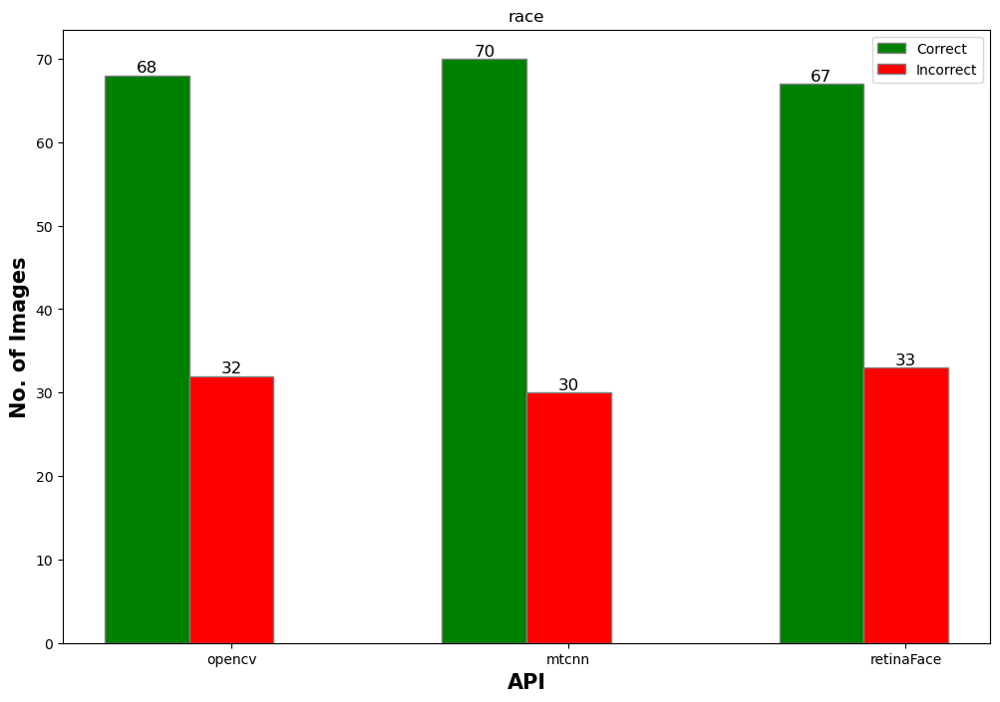

In [86]:
listOfDicts = {'opencv':BECompResOpenCV, 'mtcnn':BECompResMtcnn, 'retinaFace':BECompResRetFace}
category = 'race'
DrawBarChart(category, listOfDicts)

### Face Alignment Conclusion 

In conclusion from the minimal testing of the opencv, mtcnn & retinaface backends for the DeepFace.analyze() function the mtcnn was found to produce the best overall results. This can be seen from the tabulated data below:

opencv
- age 29% correct
- gender 55% correct
- race 68% correct

mtcnn
- age 28% correct
- gender 59% correct
- race 70% correct

retinaface
- age 26% correct
- gender 60% correct
- race 67% correct

This is also further supported by the follwoing claim made in the [DeepFace](https://github.com/serengil/deepface) github repo: 
- "RetinaFace and MTCNN seem to overperform in detection and alignment stages but they are much slower. If the speed of your pipeline is more important, then you should use opencv or ssd. On the other hand, if you consider the accuracy, then you should use retinaface or mtcnn."

The above claim is in line with the output provided in this notebook however retinaface seems to be producing subpar results given the particuals FairFace dataset images

### CLIP paramater testing

Throughout this section the aesthetic_score & aesthetic _weight paramaters alongside the prompt are tested to determine the affecet they have on the retrieved images, if any.

The CLIP prompt will also be altered to determine whether the use of simplistic prompts produces better images than complex prompts or vice versa. 

The aesthetic_score & aesthetic_weight paramaters will be assigned values at random and the images retrieved will then be compared. This is done so as to determine if the variation of said paramaters produces any significant impact on the retrieved images.

#### CLIP Prompt Testing

In [111]:
# Function used to search up images in the LAION-5B dataset and display the results
def DisplaySearchedImages(text, aes_score,aes_weight, num_of_images):

    img_results = retrieveImages(text, aes_score, aes_weight, num_of_images+1)
    
    # Retrieving the images from their respective url
    for x in range(len(img_results)):
        image_url = img_results[x]['url']

        try:
            image_data = urllib.request.urlopen(image_url)

            # Read the downloaded image data
            image = plt.imread(image_data, format='jpg')

            plt.imshow(image)
            plt.axis("Off")
            plt.show()

        except Exception as error:
            print(error)

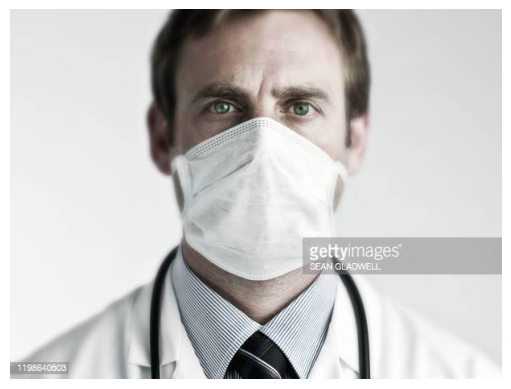

HTTP Error 403: Forbidden


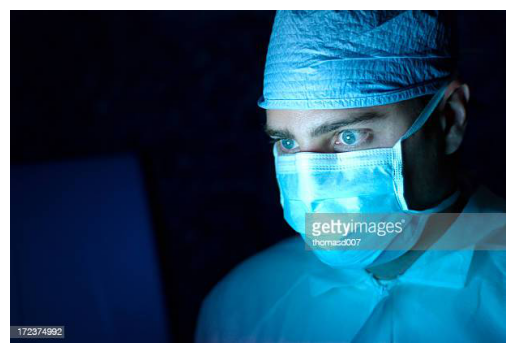

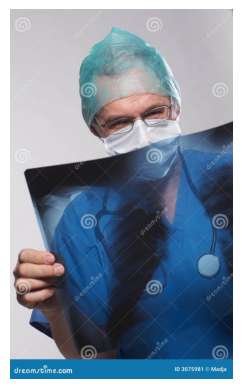

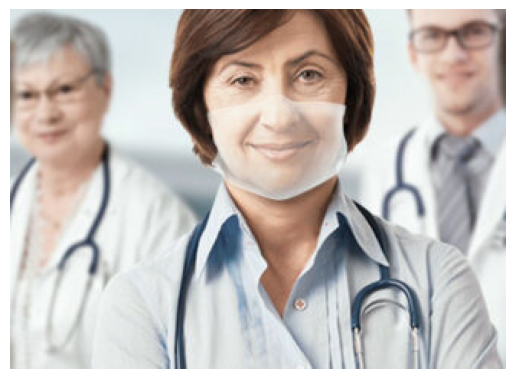

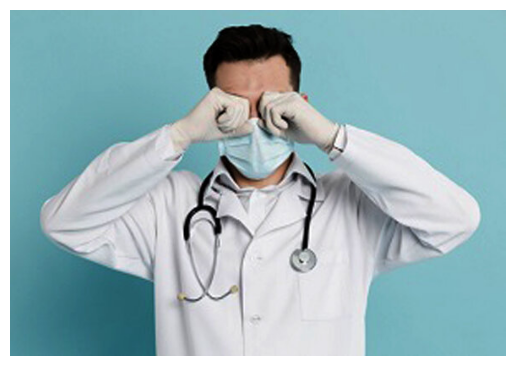

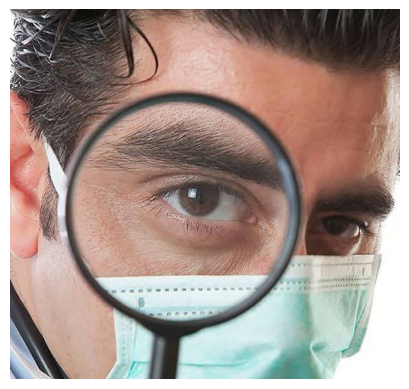

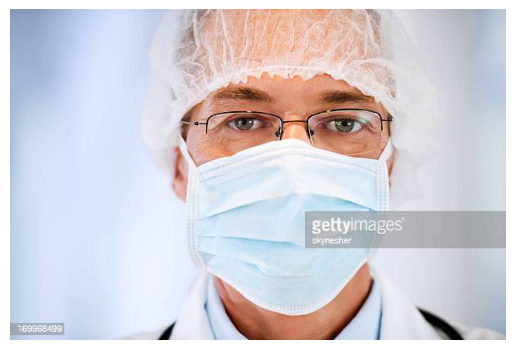

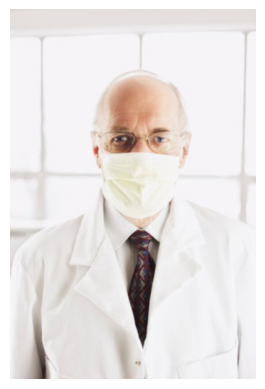

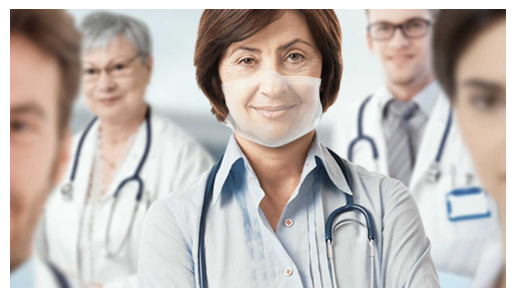

HTTP Error 403: Forbidden
HTTP Error 403: Forbidden


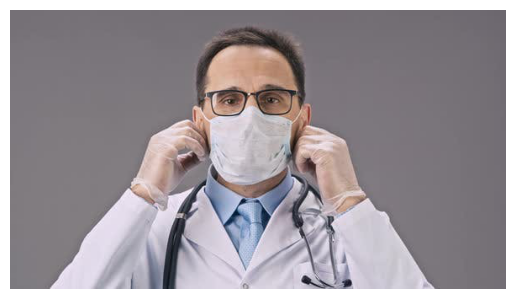

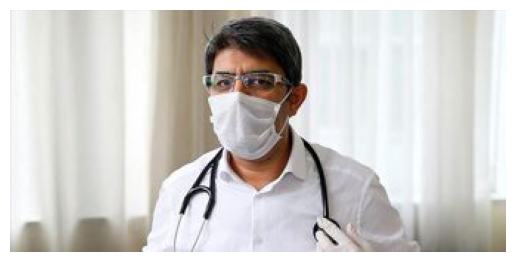

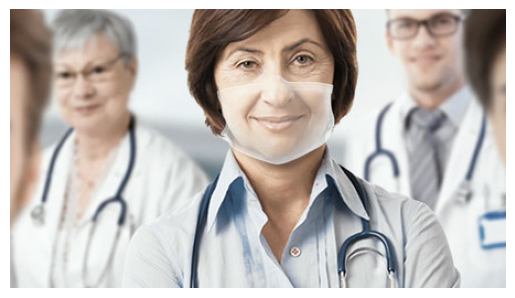

HTTP Error 403: Forbidden


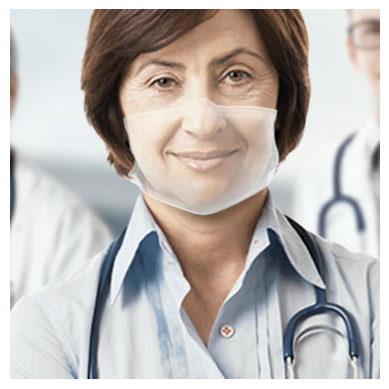

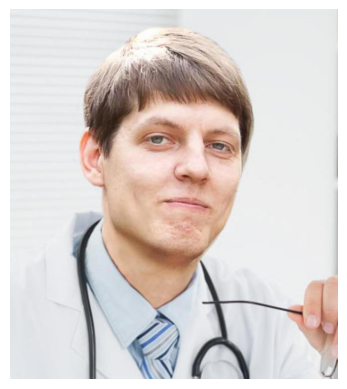

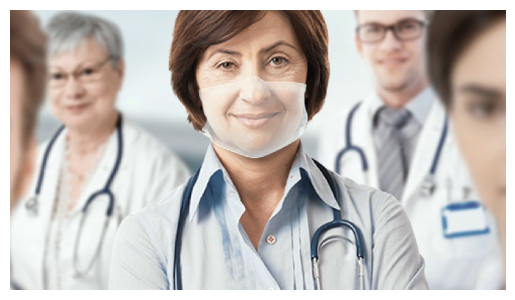

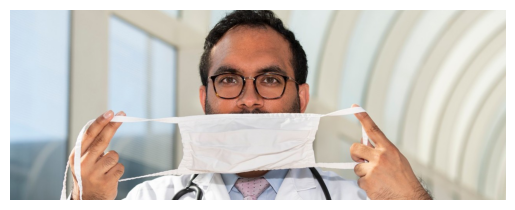

HTTP Error 404: Not Found


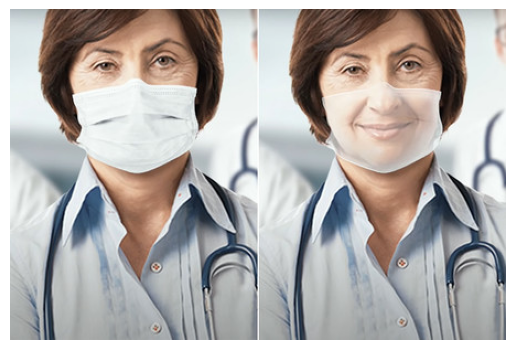

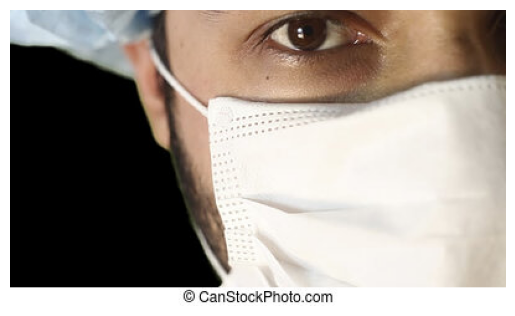

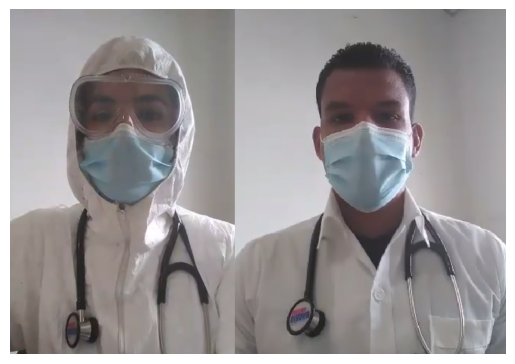

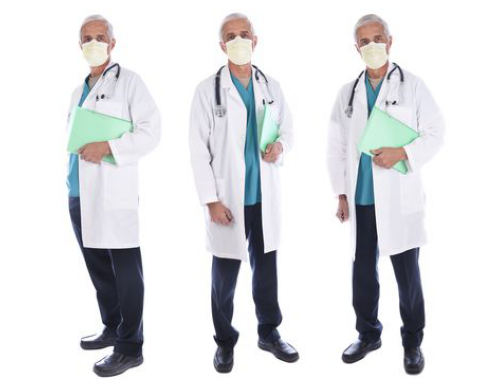

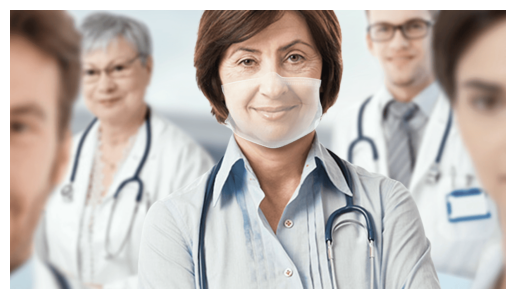

HTTP Error 403: Forbidden
<urlopen error [SSL: SSLV3_ALERT_HANDSHAKE_FAILURE] sslv3 alert handshake failure (_ssl.c:997)>


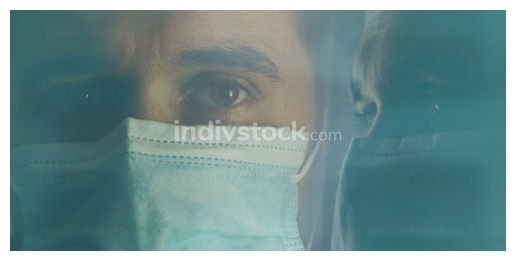

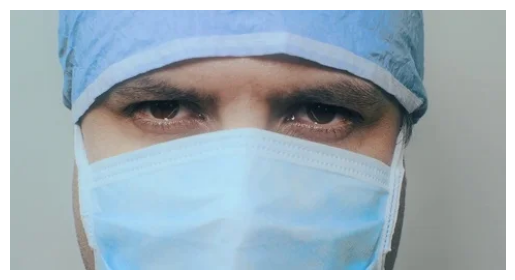

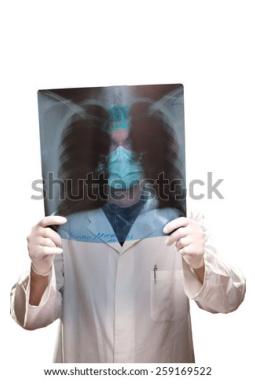

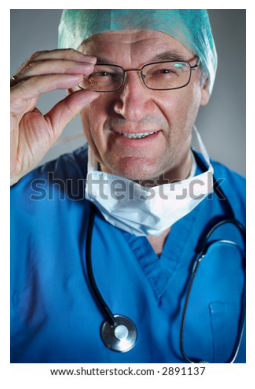

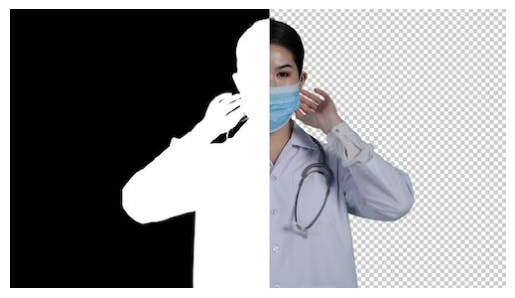

...

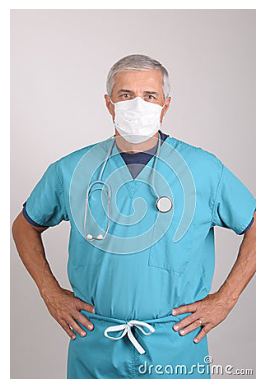

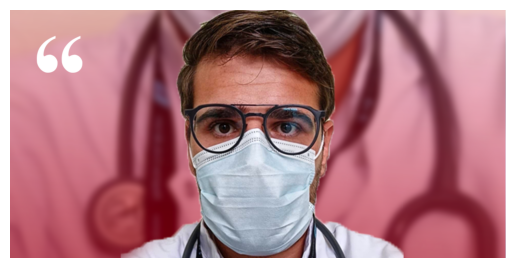

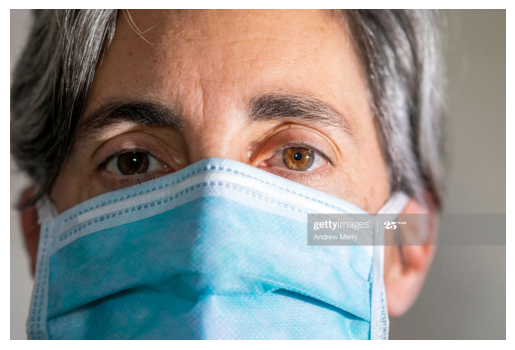

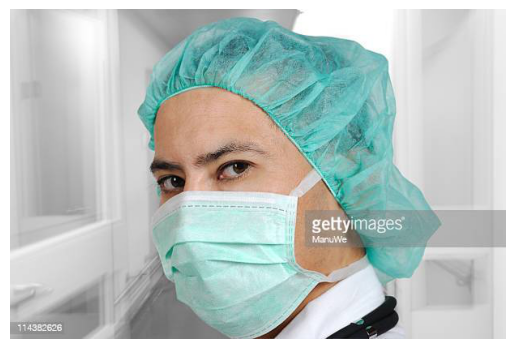

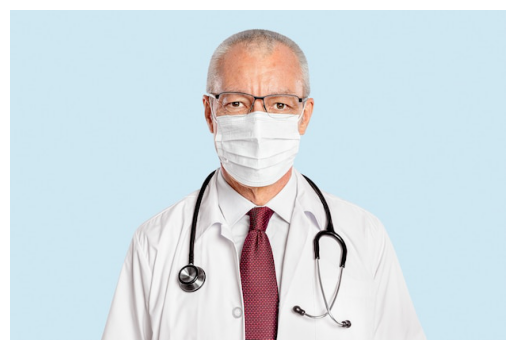

HTTP Error 403: Forbidden


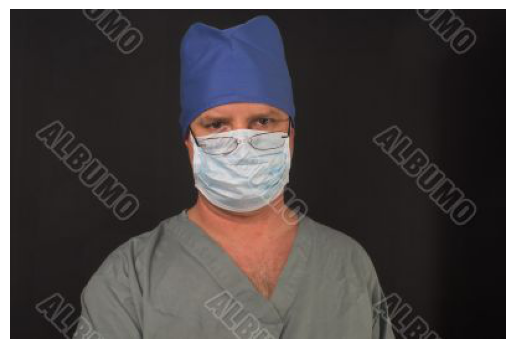

HTTP Error 400: Bad Request


In [112]:
# Retrieving the indicated images 
text = "Real Doctor with clear visibility of faces"
aes_score = 9
aes_weight = 0.5
num_of_images = 50

DisplaySearchedImages(text, aes_score,aes_weight, num_of_images)

HTTP Error 404: Not Found


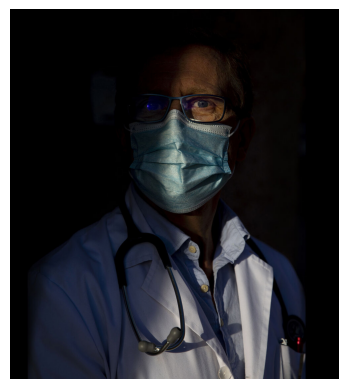

HTTP Error 403: Forbidden


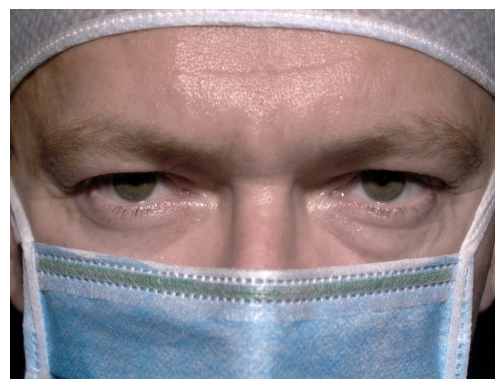

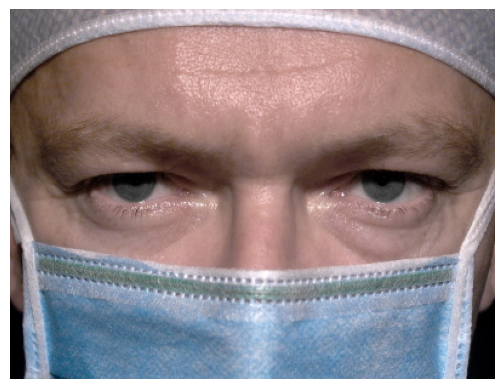

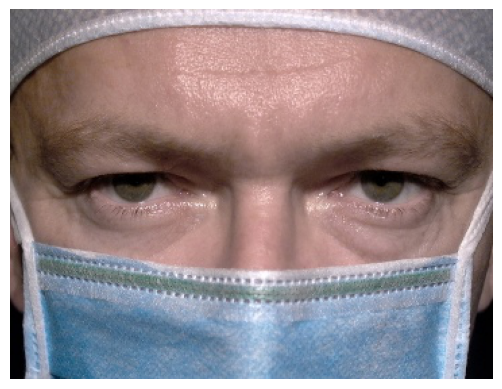

HTTP Error 403: Forbidden
HTTP Error 403: Forbidden


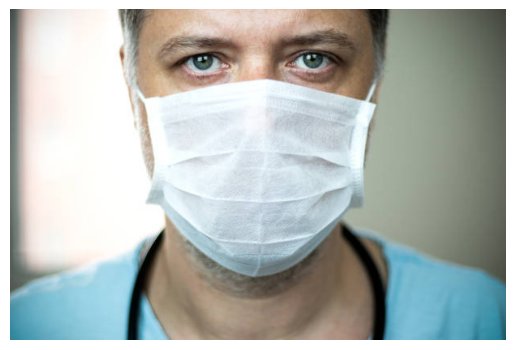

HTTP Error 403: Forbidden


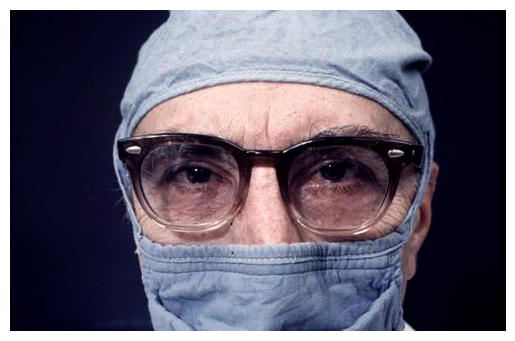

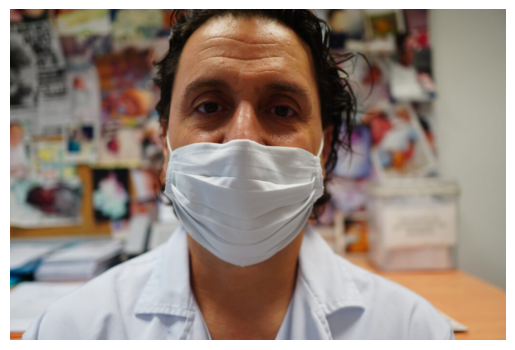

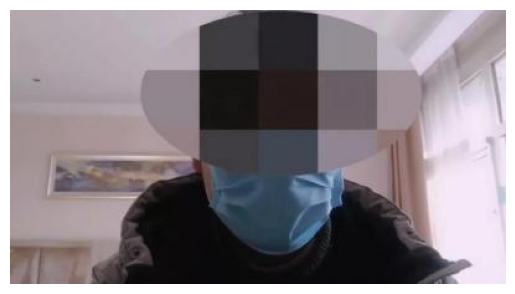

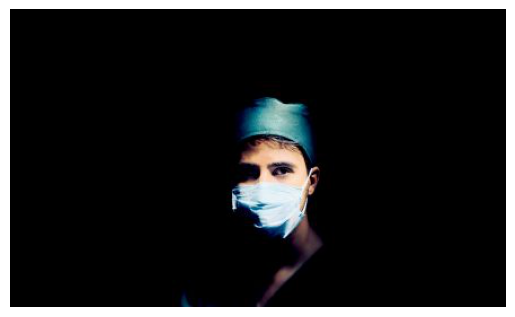

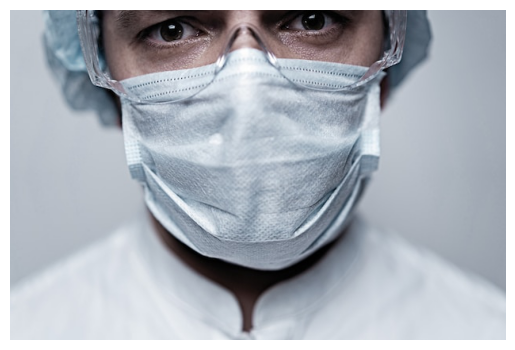

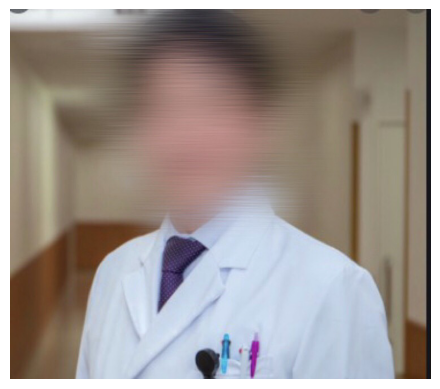

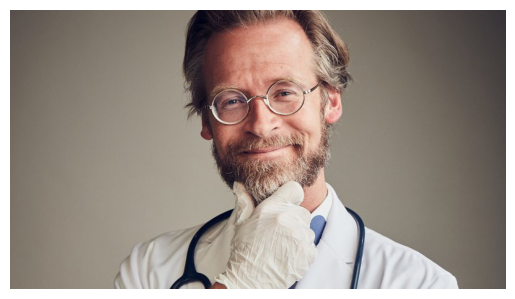

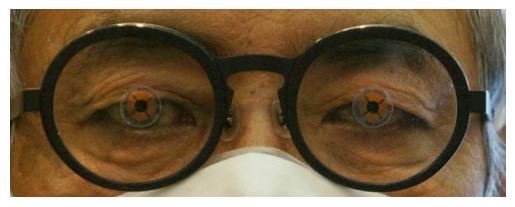

<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: Hostname mismatch, certificate is not valid for 'cdn.nowiny.pl'. (_ssl.c:997)>
<urlopen error [SSL: WRONG_SIGNATURE_TYPE] wrong signature type (_ssl.c:997)>


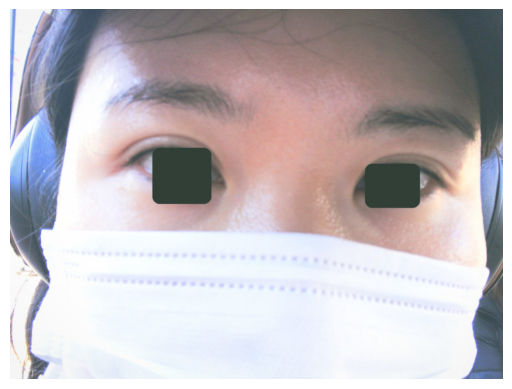

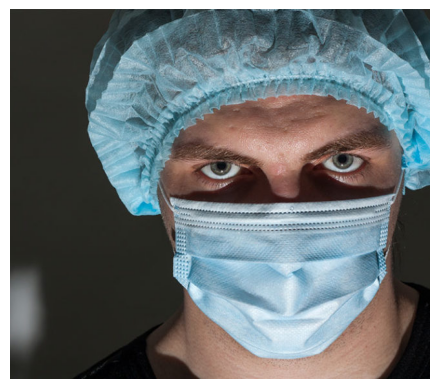

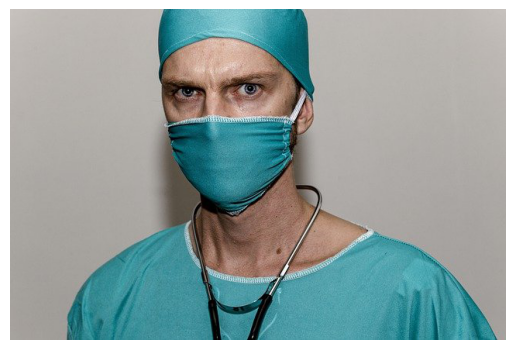

HTTP Error 403: Forbidden


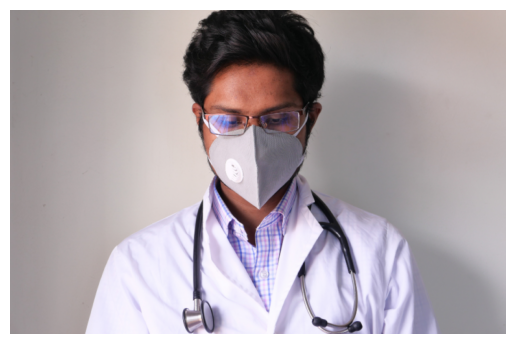

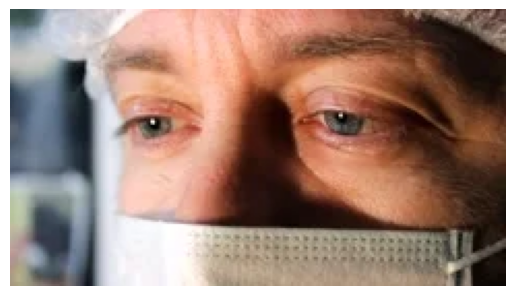

cannot identify image file <_io.BytesIO object at 0x0000023DA02DA2A0>


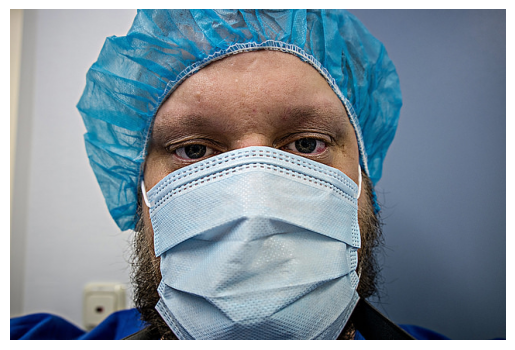

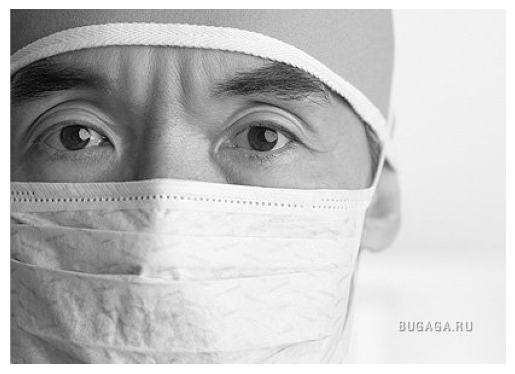

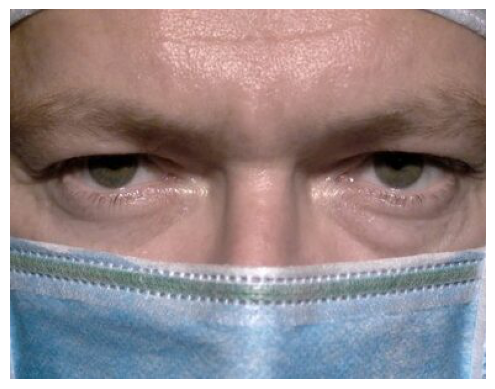

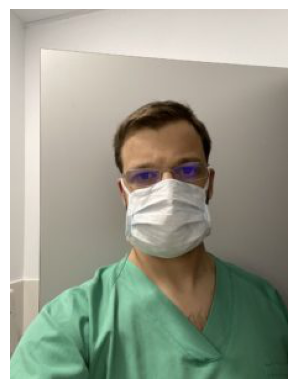

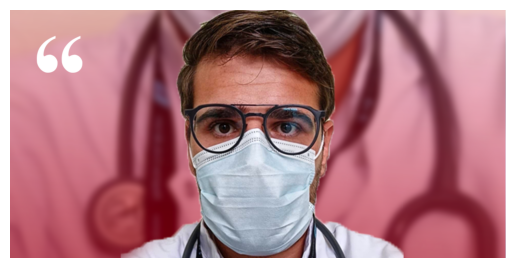

...

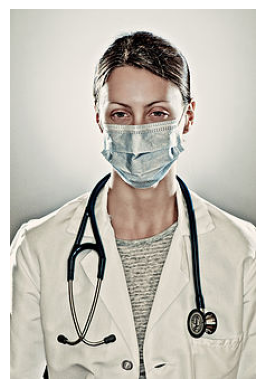

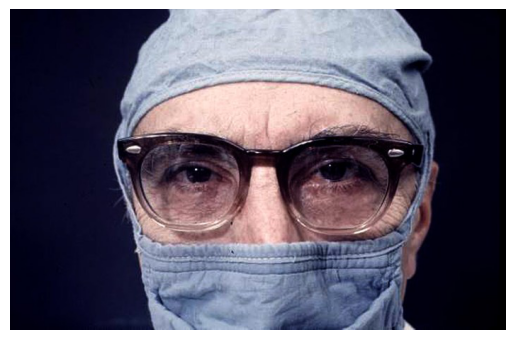

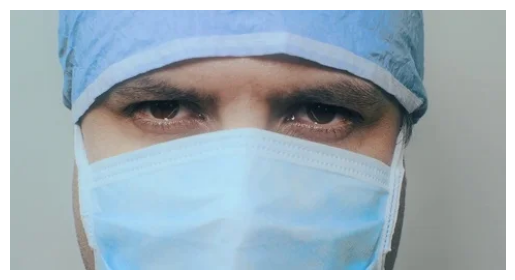

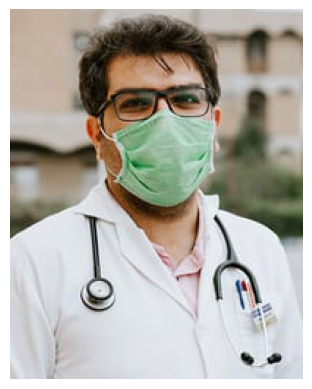

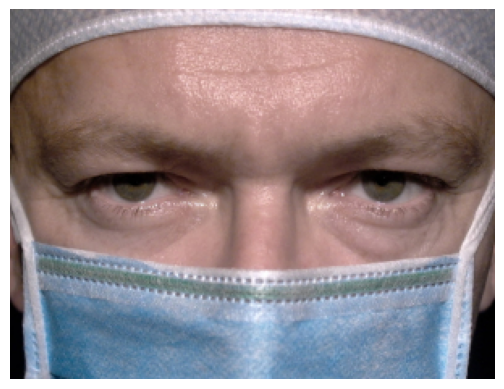

In [113]:
# Retrieving the indicated images 
text = "Picture of a singular doctor facing the camera with a visible face"
aes_score = 9
aes_weight = 0.5
num_of_images = 50

DisplaySearchedImages(text, aes_score,aes_weight, num_of_images)

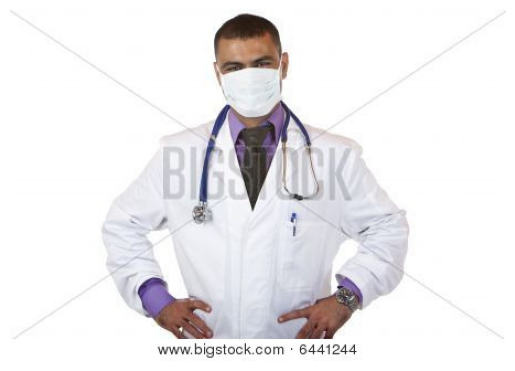

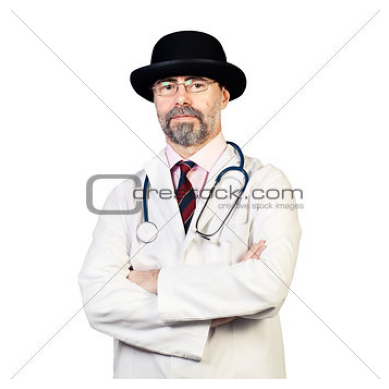

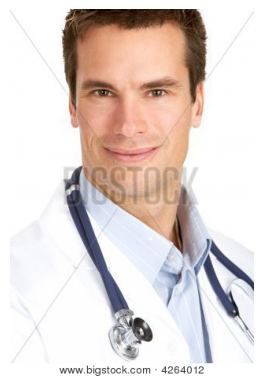

HTTP Error 403: Forbidden


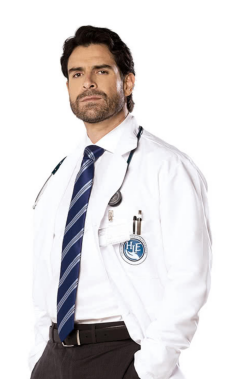

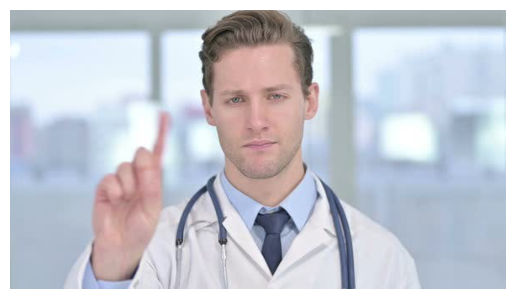

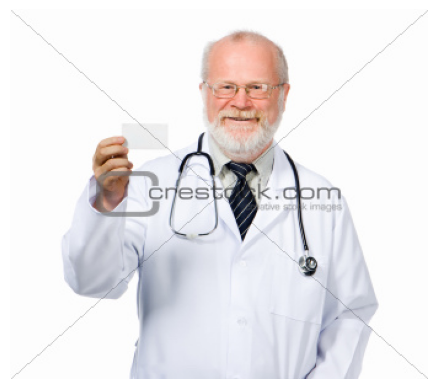

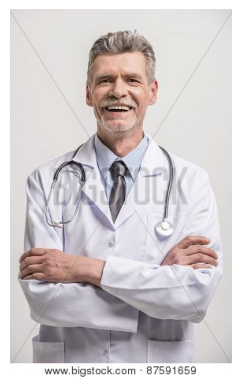

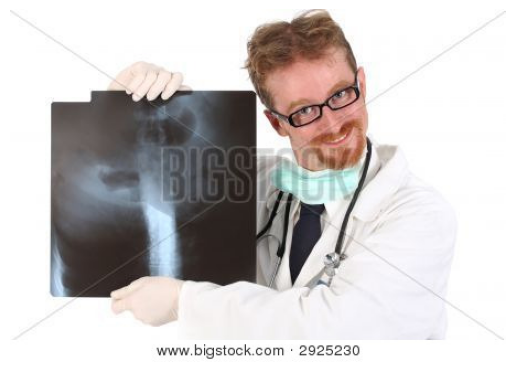

...

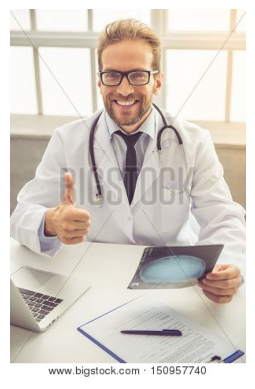

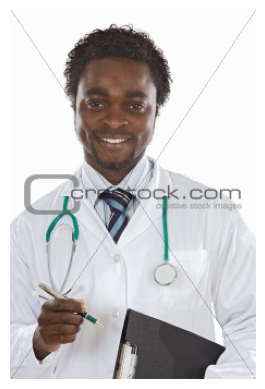

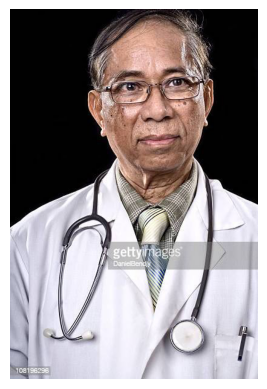

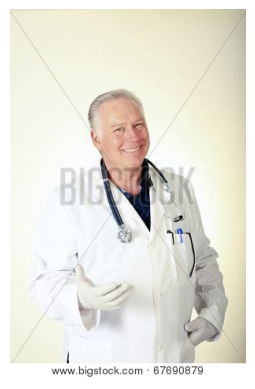

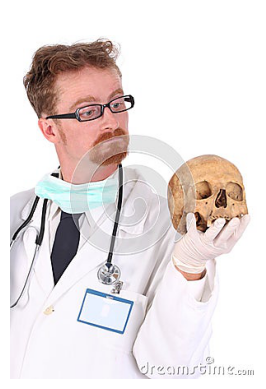

HTTP Error 404: Not Found


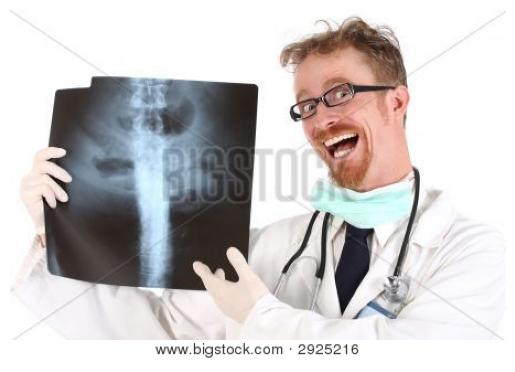

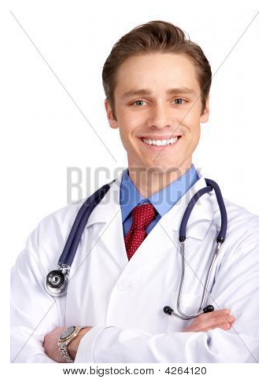

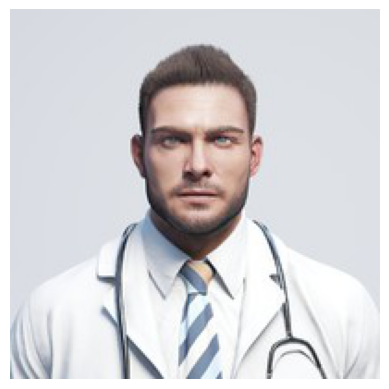

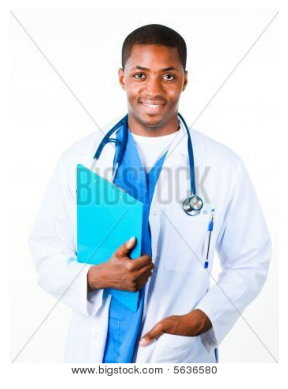

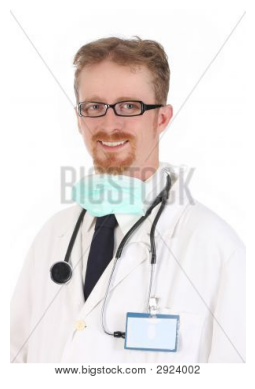

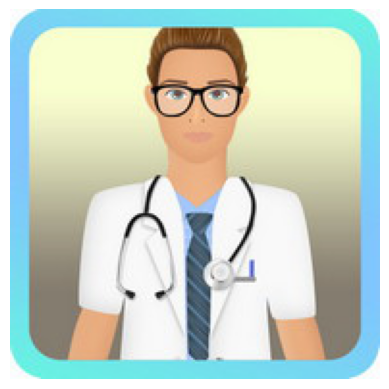

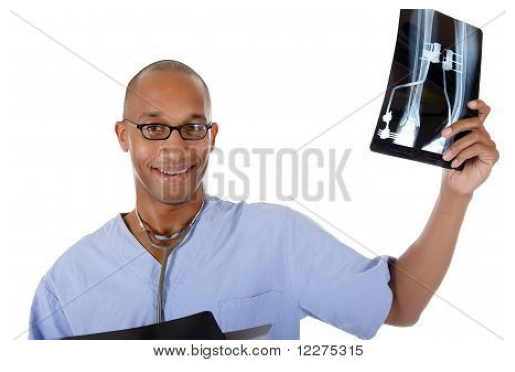

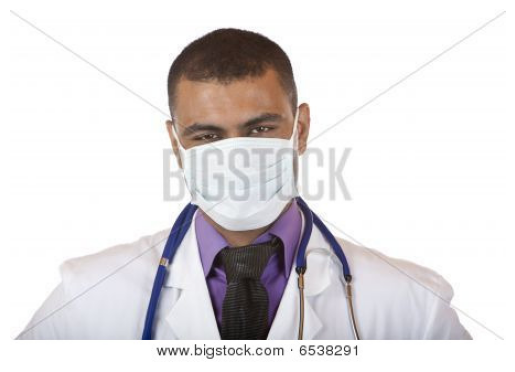

In [114]:
# Retrieving the indicated images 
text = "Real Human Doctor"
aes_score = 9
aes_weight = 0.5
num_of_images = 50

DisplaySearchedImages(text, aes_score,aes_weight, num_of_images)

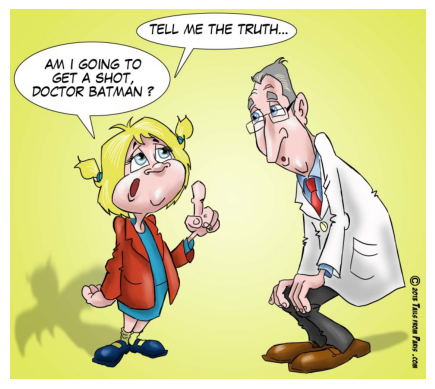

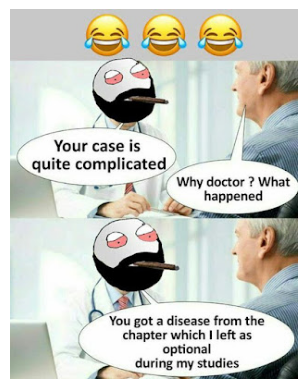

HTTP Error 403: Forbidden


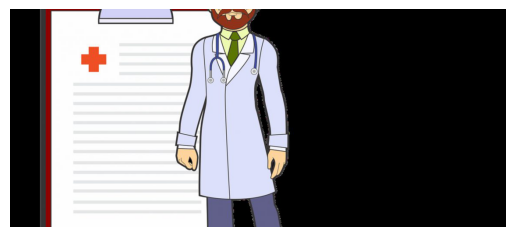

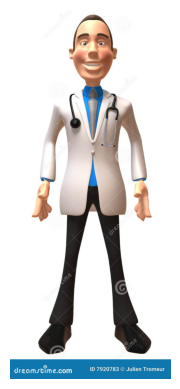

HTTP Error 403: Forbidden


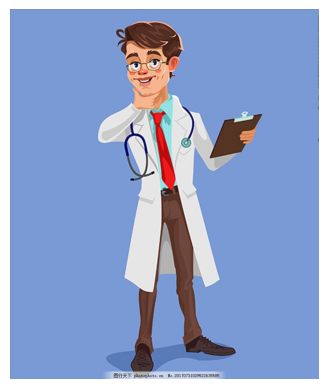

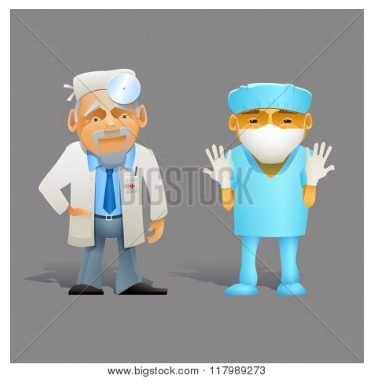

HTTP Error 404: Not Found
HTTP Error 403: Forbidden
HTTP Error 404: Not Found


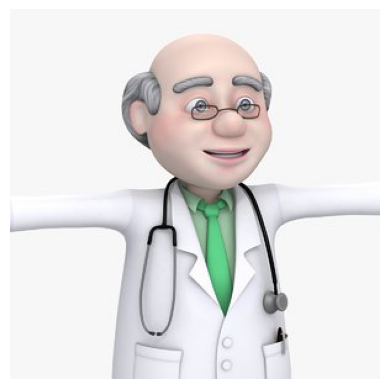

<urlopen error [Errno 11001] getaddrinfo failed>
HTTP Error 403: Forbidden


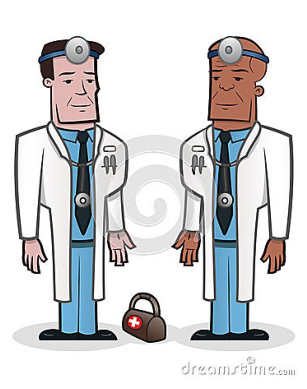

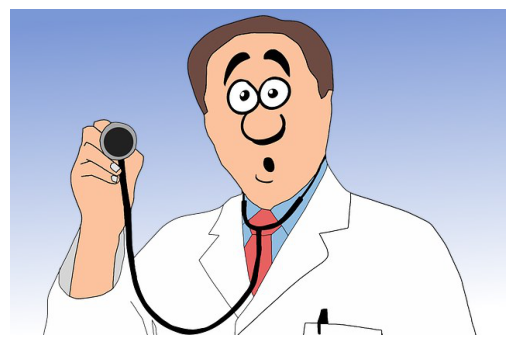

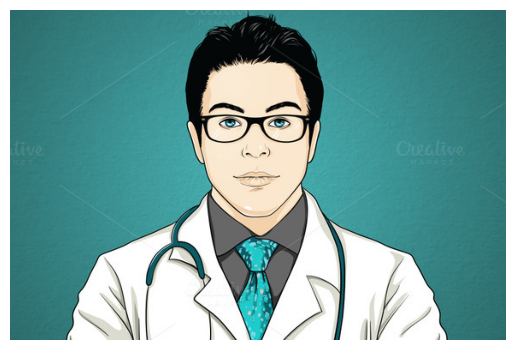

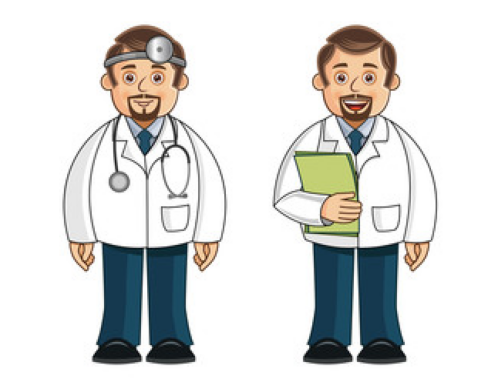

HTTP Error 403: Forbidden
HTTP Error 403: Forbidden
HTTP Error 404: Not Found


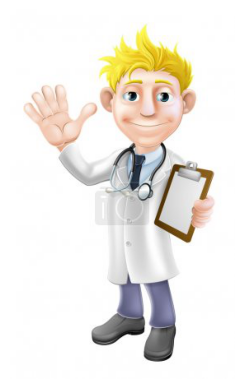

HTTP Error 403: Forbidden
HTTP Error 403: Forbidden
HTTP Error 404: Not Found
HTTP Error 404: Not Found
HTTP Error 403: Forbidden


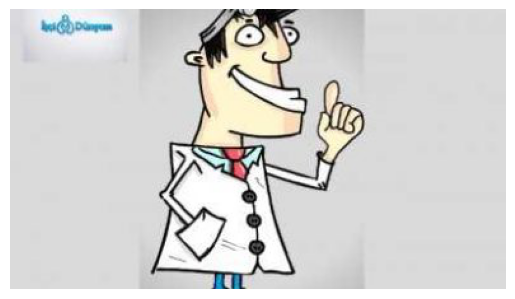

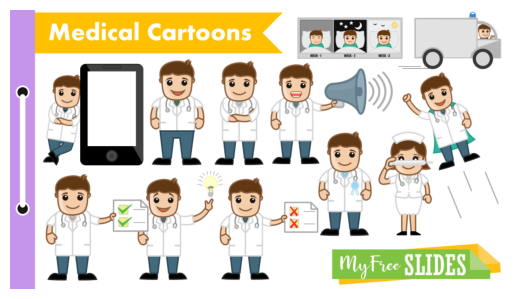

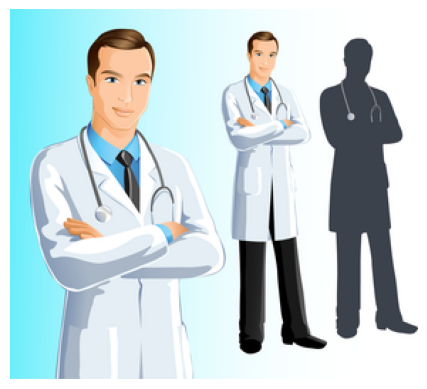

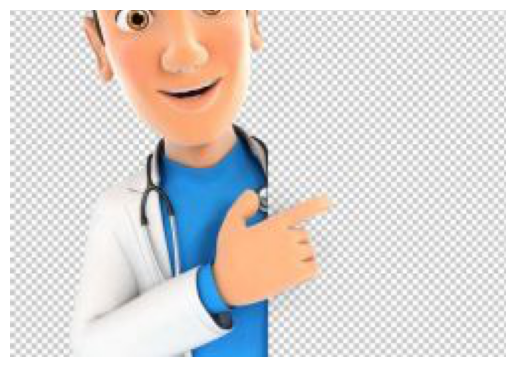

HTTP Error 403: Forbidden


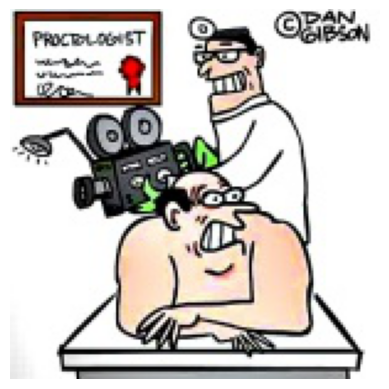

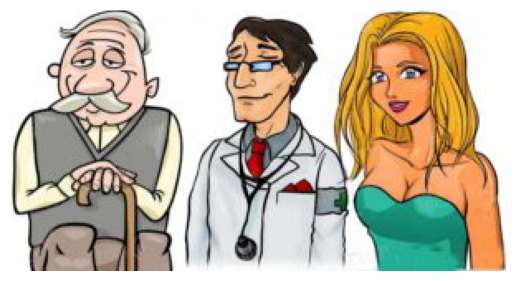

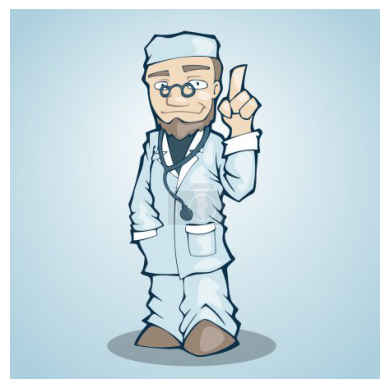

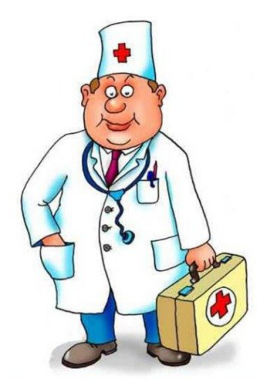

HTTP Error 403: Forbidden


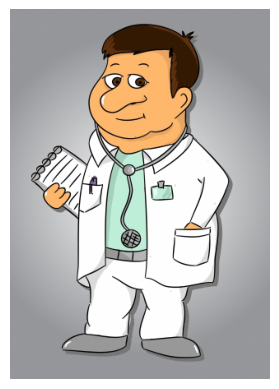

HTTP Error 403: Forbidden


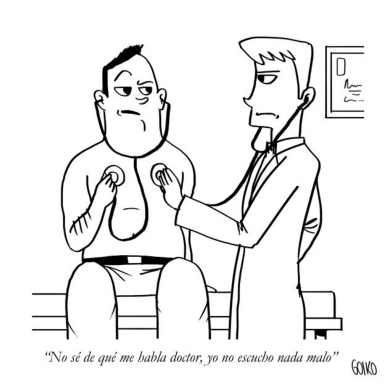

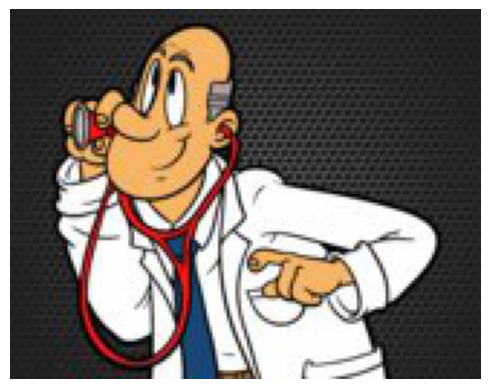

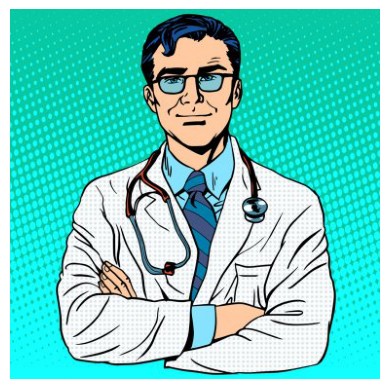

In [115]:
# Retrieving the indicated images 
text = "Real Human Doctor Not Cartoon"
aes_score = 9
aes_weight = 0.5
num_of_images = 50

DisplaySearchedImages(text, aes_score,aes_weight, num_of_images)

In accordance with the outputs produced above the simple queries produce images as requested. In contrary the mention of the words **not cartoon** produced the opposite affec wherein all the images retrieved were of cartoon characters. With regards to the longer queries they didnt produce bette results than the shorter queries however by specifying **visible faces** the faces of the people in the images were in fact visible however most of them were covered with masks given the generl prompt of a **doctor**.

#### Clip Paramater Testing

In [87]:
# Function which measures the similarity between two images utilising the MSE
def ImageSimilarity(img1, img2, threshold=1000):
    
    # Checking if the images have the same dimensions
    if img1.shape != img2.shape:
        return False

    # Calculate the Mean Squared Error (MSE)
    mse = ((img1 - img2) ** 2).mean()

    # Compare MSE with threshold
    return mse < threshold

In [88]:
# Using Aesthetic score of 0 & aesthetic weight of 0 as a basline
text = "Real Female Human Doctor"
aes_scores = [0,0,100,100,55]
aes_weights = [0,100,0,100,74]
num_of_images = 100 

ClipParamsDict = {}

for index in range(len(aes_scores)):
    if len(aes_scores) == len(aes_weights):
        listOfImages = retrieveImages(text, aes_scores[index], aes_weights[index], num_of_images)
        
        ClipParamsImgs = []
        
        for img_url in listOfImages:
            try:
                image_data = urllib.request.urlopen(img_url['url'])

                img = plt.imread(image_data, format='jpg')

                ClipParamsImgs.append(img)
            except Exception as error:
                print("[Val Pair "+str(index)+"] "+str(error))
        
        ClipParamsDict[index] = ClipParamsImgs

[Val Pair 0] HTTP Error 403: Forbidden
[Val Pair 0] HTTP Error 404: Not Found
[Val Pair 0] <urlopen error [SSL: SSLV3_ALERT_HANDSHAKE_FAILURE] sslv3 alert handshake failure (_ssl.c:997)>
[Val Pair 0] <urlopen error [Errno 11001] getaddrinfo failed>
[Val Pair 0] HTTP Error 403: Forbidden
[Val Pair 0] HTTP Error 403: Forbidden
[Val Pair 0] HTTP Error 403: Forbidden
[Val Pair 1] HTTP Error 403: Forbidden
[Val Pair 1] HTTP Error 404: Not Found
[Val Pair 1] <urlopen error [SSL: SSLV3_ALERT_HANDSHAKE_FAILURE] sslv3 alert handshake failure (_ssl.c:997)>
[Val Pair 1] <urlopen error [Errno 11001] getaddrinfo failed>
[Val Pair 1] HTTP Error 403: Forbidden
[Val Pair 1] HTTP Error 403: Forbidden
[Val Pair 1] HTTP Error 403: Forbidden
[Val Pair 2] HTTP Error 403: Forbidden
[Val Pair 2] HTTP Error 404: Not Found
[Val Pair 2] <urlopen error [SSL: SSLV3_ALERT_HANDSHAKE_FAILURE] sslv3 alert handshake failure (_ssl.c:997)>
[Val Pair 2] <urlopen error [Errno 11001] getaddrinfo failed>
[Val Pair 2] HTTP E

In [94]:
for index in range(len(ClipParamsDict)):
    index2 = (index+1)%len(ClipParamsDict)
    for listIndex in range(len(ClipParamsDict[index])):
        matched = False
        for listIndex2 in range(len(ClipParamsDict[(index2)])):

            if ImageSimilarity(ClipParamsDict[index][listIndex],ClipParamsDict[index2][listIndex2]):
                matched = True
                
        if matched == False:
            print("Image "+str(listIndex)+" in list "+str(index)+" does not match with any image in list "+str(index2))

Image 63 in list 2 does not match with any image in list 3


In [ ]:
# Write a conclusion on this section